In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
from tqdm import tqdm
from matplotlib.dates import DateFormatter
from scipy.stats import linregress # Linear Regression

# T-test
from scipy import stats
from scipy.stats import ttest_ind
from scipy.stats import ttest_1samp
import seaborn as sns
from pandas.io.formats.style_render import format_table_styles
import os
from datetime import datetime
# import re, nltk, spacy
import string
import math
from scipy.stats import pearsonr, spearmanr
from pandas.api.types import is_numeric_dtype
from scipy.signal import find_peaks

# Create custom legend handles
from matplotlib.lines import Line2D

# Non-Linear Fit
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score

# Create Master Directory

In [2]:
# Get current date in YYYY-MM-DD format
current_date = datetime.now().strftime('%Y-%m-%d')

# Define the directory name with the current date
dir_name = f"Raritan_{current_date}"

# Create the directory
if not os.path.exists(dir_name):
    os.makedirs(dir_name)
else:
    print(f"Directory {dir_name} already exists!")

# Data Preprocessing

In [3]:
# NOTE: need to change the field type to number in the CSV
df = pd.read_csv('Batches 103023.csv')

# Create Data Subdirectory
sub_dir = 'data'
if not os.path.exists(os.path.join(dir_name, sub_dir)):
  os.makedirs(os.path.join(dir_name, sub_dir))
file_path = os.path.join(dir_name, sub_dir, "Raw_Data_Batches_103023.csv")
df.to_csv(file_path)


In [4]:
df = df.replace(['#VALUE!','Not Reported','Not Reportable','Unable to generate results','',' '], np.nan)
df['Date of QA Release'] = df['Date of QA Release'].replace(['CANCELLED','REJECTED','REMANUFACTURED','TERMINATED'], np.nan)
df['Post Thaw FLOW CD4+ (%)'] = df['Post Thaw FLOW CD4+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Thaw FLOW CD8+ (%)'] = df['Post Thaw FLOW CD8+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Thaw FLOW CD4:CD8 (CALC)'] = df['Post Thaw FLOW CD4:CD8 (CALC)'].replace(['N/A','Not Reported'], np.nan)
df['Post Thaw FLOW CD3+ (%)'] = df['Post Thaw FLOW CD3+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Thaw FLOW CD16/56+ (%)'] = df['Post Thaw FLOW CD16/56+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Thaw FLOW CD19+ (%)'] = df['Post Thaw FLOW CD19+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Thaw FLOW CD14+ (%)'] = df['Post Thaw FLOW CD14+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS FLOW CD4+ (%)'] = df['Post Wash POS FLOW CD4+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS FLOW CD8+ (%)'] = df['Post Wash POS FLOW CD8+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS Flow CD4:CD8 (CALC)'] = df['Post Wash POS Flow CD4:CD8 (CALC)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS FLOW CD3+ Viability (%)'] = df['Post Wash POS FLOW CD3+ Viability (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS FLOW CD3+ (%)'] = df['Post Wash POS FLOW CD3+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS FLOW CD16/56+ (%)'] = df['Post Wash POS FLOW CD16/56+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS FLOW CD19+ (%)'] = df['Post Wash POS FLOW CD19+ (%)'].replace(['N/A','Not Reported'], np.nan)
df['Post Wash POS FLOW CD14+ (%)'] = df['Post Wash POS FLOW CD14+ (%)'].replace(['N/A','Not Reported'], np.nan)

df['Pre-Activation Clumps: # of Clumps before massage'] = df['Pre-Activation Clumps: # of Clumps before massage'].replace('2-3', '3')
df['Pre-Activation Clumps: # of Clumps before massage'] = df['Pre-Activation Clumps: # of Clumps before massage'].replace('4+', '4')
df['Pre-Activation Clumps: # of Clumps before massage'] = df['Pre-Activation Clumps: # of Clumps before massage'].replace('N/A', '0')

df['Post-Activation Clumps: # of Clumps before massage'] = df['Post-Activation Clumps: # of Clumps before massage'].replace('2-3', '3')
df['Post-Activation Clumps: # of Clumps before massage'] = df['Post-Activation Clumps: # of Clumps before massage'].replace('4+', '4')
df['Post-Activation Clumps: # of Clumps before massage'] = df['Post-Activation Clumps: # of Clumps before massage'].replace('N/A', '0')

df['Pre-Mixing Clumps: # of Clumps'] = df['Pre-Mixing Clumps: # of Clumps'].replace('2-3', '3')
df['Pre-Mixing Clumps: # of Clumps'] = df['Pre-Mixing Clumps: # of Clumps'].replace('4+', '4')
df['Pre-Mixing Clumps: # of Clumps'] = df['Pre-Mixing Clumps: # of Clumps'].replace('N/A', '0')

df['Post-Mixing Clumps: # of Clumps'] = df['Post-Mixing Clumps: # of Clumps'].replace('2-3', '3')
df['Post-Mixing Clumps: # of Clumps'] = df['Post-Mixing Clumps: # of Clumps'].replace('4+', '4')
df['Post-Mixing Clumps: # of Clumps'] = df['Post-Mixing Clumps: # of Clumps'].replace('Clumps dissipated', '0')
df['Post-Mixing Clumps: # of Clumps'] = df['Post-Mixing Clumps: # of Clumps'].replace('N/A', '0')

df['Post-Mixing Massage: Clumps'] = df['Post-Mixing Massage: Clumps'].replace('2-3', '3')
df['Post-Mixing Massage: Clumps'] = df['Post-Mixing Massage: Clumps'].replace('4+', '4')
df['Post-Mixing Massage: Clumps'] = df['Post-Mixing Massage: Clumps'].replace('Clumps dissipated', '0')
df['Post-Mixing Massage: Clumps'] = df['Post-Mixing Massage: Clumps'].replace('N/A', '0')

df['Day 3 Trasduction Incubator Out CO2 Saturation (%)'] = df['Day 3 Trasduction Incubator Out CO2 Saturation (%)'].replace('N/A', np.nan)
df['Viable Cell Concentration of VSV-g Sample (cells/mL)'] = df['Viable Cell Concentration of VSV-g Sample (cells/mL)'].replace('Not Reported', np.nan)
df['Viability of VSVg Sample (%)'] = df['Viability of VSVg Sample (%)'].replace('Not Reported', np.nan)
df['Day 8 Glucose G-Rex A (g/L)'] = df['Day 8 Glucose G-Rex A (g/L)'].replace(['N/A','Not Reported'], np.nan)
df['Day 8 Glucose G-Rex B (g/L)'] = df['Day 8 Glucose G-Rex B (g/L)'].replace(['N/A','Not Reported'], np.nan)
df['Day 8 Lactate G-Rex A (g/L)'] = df['Day 8 Lactate G-Rex A (g/L)'].replace(['N/A','Not Reported'], np.nan)
df['Day 8 Lactate G-Rex B (g/L)'] = df['Day 8 Lactate G-Rex B (g/L)'].replace(['N/A','Not Reported'], np.nan)
df['Harvest Glucose (g/L)'] = df['Harvest Glucose (g/L)'].replace(['N/A','Not Reported'], np.nan)
df['Harvest Lactate (g/L)'] = df['Harvest Lactate (g/L)'].replace(['N/A','Not Reported'], np.nan)
df['Number of Bags'] = df['Number of Bags'].replace(['N/A','Not Reported'], np.nan)
df['Time Pre-formulated Bulk Removed (hh:mm)'] = df['Time Pre-formulated Bulk Removed (hh:mm)'].replace(['N/A','Not Reported'], np.nan)
df['Endotoxin (EU/mL)'] = df['Endotoxin (EU/mL)'].replace(['<0.05', '<0.04'], '0.05')
df['Day 3 VSVg Result'] = df['Day 3 VSVg Result'].replace(['N/A','Non Reportable'], np.nan)
df['Day 10 VSVg Result'] = df['Day 10 VSVg Result'].replace(['N/A','<LLOQ'], np.nan)
df['Day 10 VSVg Result'] = df['Day 10 VSVg Result'].replace('<200', '200')
df['Day 3 VSVg Result'] = df['Day 3 VSVg Result'].replace('<200', '200')
df['Day 3 VSVg Result'] = df['Day 3 VSVg Result'].replace(['N/A','Not Reportable'], np.nan)
df['FP Post-Thaw Viability (%)'] = df['FP Post-Thaw Viability (%)'].replace(['N/A','Not Reportable','<'], np.nan)
df['FP Flow CD3+ Viability (%)'] = df['FP Flow CD3+ Viability (%)'].replace(['N/A','Not Reportable'], np.nan)
df['Provirus Transduction Efficiency (vector copies/cell)'] = df['Provirus Transduction Efficiency (vector copies/cell)'].replace('>8.00', 8)
df['Provirus Transduction Efficiency (vector copies/cell)'] = df['Provirus Transduction Efficiency (vector copies/cell)'].replace(['N/A','Not Reportable'], np.nan)
df['FP Flow CD19+ (%)'] = df['FP Flow CD19+ (%)'].replace(['N/A','Not Reportable'], np.nan)
df['FP Flow NK CD3-CD16+CD56+ cells (%)'] = df['FP Flow NK CD3-CD16+CD56+ cells (%)'].replace(['N/A','Not Reportable'], np.nan)
df['FP Flow CD3+ (%)'] = df['FP Flow CD3+ (%)'].replace(['N/A','Not Reportable'], np.nan)
df['Viable Cell Concentration (cells/mL)'] = df['Viable Cell Concentration (cells/mL)'].replace(['N/A','Not Reportable'], np.nan)
df['Provirus Vector Copy Number (copies/transduced cell)'] = df['Provirus Vector Copy Number (copies/transduced cell)'].replace(['N/A','Not Reportable'], np.nan)
df['Total Viable Cell Count (TNC) (cells)'] = df['Total Viable Cell Count (TNC) (cells)'].replace(['N/A','Not Reportable'], np.nan)
df['Dose (CAR+ viable cells/kg)'] = df['Dose (CAR+ viable cells/kg)'].replace(['N/A','Not Reportable'], np.nan)
df['Dose: Number of CAR+ Viable T-Cells (cells)'] = df['Dose: Number of CAR+ Viable T-Cells (cells)'].replace(['N/A','Not Reportable'], np.nan)
df['FP Flow CAR+ (%)'] = df['FP Flow CAR+ (%)'].replace(['N/A','Not Reportable'], np.nan)
df['IFN Gamma'] = df['IFN Gamma'].replace(['N/A','Not Reportable','No Result','No result','Not Reported'], np.nan)

df['Day 10 VSVg Result'] = df['Day 10 VSVg Result'].astype(float)
df['Day 3 VSVg Result'] = df['Day 3 VSVg Result'].astype(float)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1900 entries, 0 to 1899
Columns: 342 entries, Patient Lot/Batch # to FP Visual Inspection Result
dtypes: float64(131), int64(1), object(210)
memory usage: 5.0+ MB


## Create Acceptance Criteria Columns

In [5]:
df[['Dose (CAR+ viable cells/kg)','Dose: Number of CAR+ Viable T-Cells (cells)']] = df[['Dose (CAR+ viable cells/kg)','Dose: Number of CAR+ Viable T-Cells (cells)']].replace(" ", np.nan)
df[['Dose (CAR+ viable cells/kg)','Dose: Number of CAR+ Viable T-Cells (cells)']] = df[['Dose (CAR+ viable cells/kg)','Dose: Number of CAR+ Viable T-Cells (cells)']].apply(pd.to_numeric)

In [6]:
df['Acceptance Criteria - Appearance of Color'] = np.where(df['Appearance of Color'].isnull(),np.nan,np.where(df['Appearance of Color'] == "Colorless to white", "Pass", "Fail"))
df['Acceptance Criteria - Appearance of Primary Container'] = np.where(df['Appearance of Color'].isnull(),np.nan,np.where(df['Appearance of Primary Container'] == "Pass", "Pass", "Fail"))
df['Acceptance Criteria - Rapid Sterility'] = np.where(df['Appearance of Color'].isnull(),np.nan,np.where(df['BacT/Alert Rapid Sterility'].str.contains("No Growth", na=False, case=False), "Pass","Fail"))
df['Acceptance Criteria - Endotoxin (EU/mL)'] = df['Endotoxin (EU/mL)']
df['Acceptance Criteria - Mycoplasma'] = np.where(df['Appearance of Color'].isnull(),np.nan,np.where(df['Mycoplasma'] == "Not Detected", "Pass", "Fail"))
df['Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)'] = df['Day 3 VSVg Result']/df['Day 10 VSVg Result']
df['Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)'] = df['Provirus Vector Copy Number (copies/transduced cell)']
df['Acceptance Criteria - Post-thaw Viability'] = df['FP Post-Thaw Viability (%)']
df['Acceptance Criteria - Phenotype (% B cells)'] = df['FP Flow CD19+ (%)']
df['Acceptance Criteria - Phenotype (% NK cells)'] = df['FP Flow NK CD3-CD16+CD56+ cells (%)']
df['Acceptance Criteria - Phenotype (% T cells)'] = df['FP Flow CD3+ Viability (%)']
df['Acceptance Criteria - CAR Identity'] = np.where(df['Appearance of Color'].isnull(),np.nan,np.where(df['FP Flow CAR Identity'] == "Positive for detection of CAR transgene", "Pass", "Fail"))
df['Acceptance Criteria - Viable Cell Concentration (cells/mL)'] = df['Final Formulation CS5 Viable Cell Concentration Average (cells/mL)']
df['Acceptance Criteria - CAR+ Viable T cells (cells/kg)'] = np.where(df['Subject Weight (kg)'] < 100, df['Dose (CAR+ viable cells/kg)'], df['Dose: Number of CAR+ Viable T-Cells (cells)']/100)
df['Acceptance Criteria - CAR Expression (%)'] = df['FP Flow CAR+ (%)']
df['Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)'] = df['IFN Gamma']

df['Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)'] = df['Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)'].replace(r'\D+', np.nan)
df['Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)'] = df['Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)'].astype(float)

# Replace infinities with NaN
df.replace([np.inf, -np.inf], np.nan, inplace=True)

In [7]:
# Save cleaned data
sub_dir = 'data'
file_path = os.path.join(dir_name, sub_dir, "Cleaned Batches.csv")
df.to_csv(file_path, encoding='utf-8', index=False)

# **Correlation Matrices and P-Values**

In [8]:
# Read in specs csv
spec = pd.read_csv('Batch_Specs.csv') # Thresholds for upper and lower-limit specs
cols =  ['Acceptance Criteria - Endotoxin (EU/mL)',
        'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)',
        'Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)',
        'Acceptance Criteria - Post-thaw Viability',
        'Acceptance Criteria - Phenotype (% B cells)',
        'Acceptance Criteria - Phenotype (% NK cells)',
        'Acceptance Criteria - Phenotype (% T cells)',
        'Acceptance Criteria - Viable Cell Concentration (cells/mL)',
        'Acceptance Criteria - CAR+ Viable T cells (cells/kg)',
        'Acceptance Criteria - CAR Expression (%)',
        'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)']

for col in cols:
  print(col)
  df[col] = df[col].astype('float')

Acceptance Criteria - Endotoxin (EU/mL)
Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)
Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)
Acceptance Criteria - Post-thaw Viability
Acceptance Criteria - Phenotype (% B cells)
Acceptance Criteria - Phenotype (% NK cells)
Acceptance Criteria - Phenotype (% T cells)
Acceptance Criteria - Viable Cell Concentration (cells/mL)
Acceptance Criteria - CAR+ Viable T cells (cells/kg)
Acceptance Criteria - CAR Expression (%)
Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)


## Pearson Correlation Matrix (R-Value)

In [9]:
# Create Subdirectory
sub_dir = 'Multi_Variate_Analysis_of_Acceptance_Criteria'
if not os.path.exists(os.path.join(dir_name, sub_dir)):
  os.makedirs(os.path.join(dir_name, sub_dir))

# Create correlation matrix
correlation_matrix_pearson = df.corr(method='pearson', min_periods=1)
cols_with_nan_pearson = correlation_matrix_pearson.columns[correlation_matrix_pearson.isna().all()].tolist()

correlation_matrix_pearson = correlation_matrix_pearson.drop(cols_with_nan_pearson, axis=1)
correlation_matrix_pearson = correlation_matrix_pearson.drop('Material ID', axis=1)
correlation_matrix_pearson = correlation_matrix_pearson.drop(labels=cols_with_nan_pearson,axis=0)
correlation_matrix_pearson = correlation_matrix_pearson.drop(labels='Material ID',axis=0)

# Save to filepath
file_path = os.path.join(dir_name, sub_dir, "Pearson_Correlation_Matrix.csv")
correlation_matrix_pearson.to_csv(file_path)


/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/505475484.py:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix_pearson = df.corr(method='pearson', min_periods=1)


## Spearman Correlation Matrix

In [10]:
correlation_matrix_spearman = df.corr(method='spearman', min_periods=1)
cols_with_nan_spearman = correlation_matrix_spearman.columns[correlation_matrix_spearman.isna().all()].tolist()

correlation_matrix_spearman = correlation_matrix_spearman.drop(cols_with_nan_spearman, axis=1)
correlation_matrix_spearman = correlation_matrix_spearman.drop('Material ID', axis=1)
correlation_matrix_spearman = correlation_matrix_spearman.drop(labels=cols_with_nan_spearman,axis=0)
correlation_matrix_spearman = correlation_matrix_spearman.drop(labels='Material ID',axis=0)

# Save to filepath
sub_dir = 'Multi_Variate_Analysis_of_Acceptance_Criteria'
file_path = os.path.join(dir_name, sub_dir, "Spearman_Correlation_Matrix.csv")
correlation_matrix_spearman.to_csv(file_path)

/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/235244174.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix_spearman = df.corr(method='spearman', min_periods=1)


In [11]:
df_numeric = df.select_dtypes([np.number])
df_numeric = df_numeric.replace([np.inf], np.nan)

## P-Value for Pearson Correlation Matrix

In [12]:
#Create P Value Correlation Matrix
def r_pvalues_pearson(df):
    cols = pd.DataFrame(columns=df.columns)
    p = cols.transpose().join(cols, how='outer')
    for r in df.columns:
        for c in df.columns:
            tmp = df[df[r].notnull() & df[c].notnull()]
            if len(tmp) == 0: continue
            p[r][c] = round(pearsonr(tmp[r], tmp[c])[1], 4)
    return p

correlation_Pmatrix_pearson = r_pvalues_pearson(df_numeric)
correlation_Pmatrix_pearson = correlation_Pmatrix_pearson[5:]
correlation_Pmatrix_pearson.drop(columns=correlation_Pmatrix_pearson.columns[:5], axis=1, inplace=True)

# Save to filepath
sub_dir = 'Multi_Variate_Analysis_of_Acceptance_Criteria'
file_path = os.path.join(dir_name, sub_dir, 'Pearson Pvalues Correlation Matrix.csv')
correlation_Pmatrix_pearson.to_csv(file_path)

/Users/alexyeung/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


In [13]:
def r_pvalues_spearman(df):
    cols = pd.DataFrame(columns=df.columns)
    p = cols.transpose().join(cols, how='outer')
    for r in df.columns:
        for c in df.columns:
            tmp = df[df[r].notnull() & df[c].notnull()]
            if len(tmp) == 0: continue
            p[r][c] = round(spearmanr(tmp[r], tmp[c])[1], 4)
    return p


correlation_Pmatrix_spearman = r_pvalues_spearman(df_numeric)
correlation_Pmatrix_spearman = correlation_Pmatrix_spearman[5:]
correlation_Pmatrix_spearman.drop(columns=correlation_Pmatrix_spearman.columns[:5], axis=1, inplace=True)
# Save to filepath
sub_dir = 'Multi_Variate_Analysis_of_Acceptance_Criteria'
file_path = os.path.join(dir_name, sub_dir, 'Spearman Pvalues Correlation Matrix.csv')
correlation_Pmatrix_spearman.to_csv(file_path)

/Users/alexyeung/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


## 11x11 Scatter Plot (Grid and Individual (1x1)) - NOT SAVED



In [14]:
# data_list = [] # Tuple of lists contains datasets of form (x,y)
# label_list = []
# titles, x_labels, y_labels = [], [], []

# for x_col in cols:   # ROW INDEXER

#   # t_stat, p_value, grp_inspec, grp_OOS = None, None, None, None
#   ###### Get upper/lower limit ######
#   X_floor, X_ceil = spec[x_col][0], spec[x_col][3]   # <100kg  X-Thresholds

#   # Check if thresholds are the same for ><100kg - NOT USED CURRENTLY
#   # inspec_criteria = (df[x_col]<=X_ceil) & (df[x_col]>=X_floor)
#   # OOS_criteria =    (df[x_col]> X_ceil) | (df[x_col] <X_floor)

#   for y_col in cols: # COLUMN Indexer

#     ###### Get Y upper/lower limit ######
#     # Y_ceil,   Y_floor = spec[y_col][0], spec[y_col][3]   # <100kg  X-Thresholds ## NOT USED CURRENTLY

#     ## Inspec & OOS - All X/Y pairs where BOTH X/Y do not have NaNs, Nones,
#     subset = df[(df[x_col].notna() & df[x_col].ne('') & df[x_col].ne(None)) &
#                 (df[y_col].notna() & df[y_col].ne('') & df[y_col].ne(None))]
#     subset_NaN = df[(df[x_col].isna() | df[x_col].eq('')) |
#                     (df[y_col].isna() | df[y_col].eq(''))]
#     # ALL X/Y Pairs
#     result = list(zip(subset[x_col], subset[y_col]))

#     # if x_col == 'cols =Acceptance Criteria - CAR Expression (%)' and y_col =='Acceptance Criteria - Viable Cell Concentration (cells/mL)':
#     #   result = list(zip(np.log(subset[x_col]), np.log(subset[y_col])))

#     result_NaN   = list(zip(subset_NaN[x_col], subset_NaN[y_col]))
#     # Labels
#     data_list.append(result)
#     titles.append(f'{y_col} values vs. {x_col}')
#     x_labels.append(x_col)
#     y_labels.append(y_col)

In [15]:
# # Create Subdirectory
# sub_dir = 'Quant_Scatter'
# if not os.path.exists(os.path.join(dir_name, sub_dir)):
#   os.makedirs(os.path.join(dir_name, sub_dir))

# # Calculate number of rows needed
# ncols = len(cols)
# n_subplots = len(data_list)
# nrows = -(-n_subplots // ncols)  # Calculates the ceiling of n_subplots / ncols

# # Create figure and subplot grid for 11x11 grid
# fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(64, 64))

# # Flatten axes for easier iteration
# if nrows == 1 or ncols == 1:
#     axes = axes.flatten()
# else:
#     axes = axes.reshape(-1)

# # Loop through subplots and add data
# for i, (ax, title, x_col, y_col) in enumerate(zip(axes, titles, x_labels, y_labels)):
#     if i < n_subplots:
#         x, y = zip(*data_list[i]) # Unpack TUple
#         X_floor, X_ceil = spec[x_col][0], spec[x_col][3]   # <100kg  X-Thresholds
#         #X_floor_over_100kg,  X_ceil_over_100kg  = spec[x_col][1], spec[x_col][2]   # >100kg  X-Thresholds
#         #Y_floor_under_100kg, Y_ceil_under_100kg = spec[y_col][0], spec[y_col][3]   # <100kg  X-Thresholds
#         #Y_floor_over_100kg,  Y_ceil_over_100kg  = spec[y_col][1], spec[y_col][2]   # >100kg  X-Thresholds

#         # Get in-spec and OOS INDEXES
#         # X_inspec_criteria = (df[x_col]<=X_ceil_under_100kg) & (df[x_col]>=X_floor_under_100kg)
#         # X_OOS_criteria =    (df[x_col]> X_ceil_under_100kg) | (df[x_col] <X_floor_under_100kg)
#         # Y_inspec_criteria = (df[y_col]<=Y_ceil_under_100kg) & (df[y_col]>=Y_floor_under_100kg)
#         # Y_OOS_criteria =    (df[y_col]> Y_ceil_under_100kg) | (df[y_col] <Y_floor_under_100kg)

#         # # X values
#         # x1_inspec = df[inspec_criteria][x_col].values
#         # x2_OOS = df[OOS_criteria][x_col].values

#         # colors = np.where(((x>X_floor_under_100kg) & (x<X_ceil_under_100kg) &
#         #                   (y>Y_floor_under_100kg) & (y<Y_ceil_under_100kg)), 'green', 'red')

#         # Critiria 1 - Within Spec
#         if not math.isnan(X_ceil) and not math.isnan(X_ceil):
#           cond1 = (x>=X_floor) & (x<=X_ceil)
#         elif math.isnan(X_floor):
#           cond1 = (x<=X_ceil)
#         elif math.isnan(X_ceil):
#           cond1 = (x>=X_floor)
#         # Criteria 2 - Greater than Spec
#         cond2 = (x>X_ceil)
#         # Criteria 3 - Below Spec
#         cond3 = (x<X_floor)

#         # Use numpy.select to assign colors based on conditions
#         conditions = [cond1, cond2, cond3]
#         colors_choices = ['green', 'red', 'blue']
#         colors = np.select(conditions, colors_choices)

#         ############## GRID PLOT ###################
#         # Create the scatter plot for GRID
#         ax.scatter(x, y, c=colors, s=30, alpha = 1)
#         ax.set_title(f'Graph {i + 1}')
#         ax.set_xlabel(x_col)
#         ax.set_ylabel(y_col)

#         ############## INDIVIDUAL PLOTS ##################
#         fig_1, ax_1 = plt.subplots(figsize=(10, 6))
#         ax_1.scatter(x, y, c=colors, s=30, alpha = 1)
#         ax_1.set_title(f'Graph {i + 1}')
#         ax_1.set_xlabel(x_col)
#         ax_1.set_ylabel(y_col)

#         # Calculate the line of best fit
#         x, y = np.array(x), np.array(y)
#         slope, intercept, r_value, p_value, std_err = linregress(x, y)
#         best_fit = slope * x + intercept
#         if r_value!=0:   # Only plot those with correlation
#           ax_1.plot(x, best_fit, color='red', label='Line of Best Fit')

#         # Add captions with R-value, p-value, and the linear equation
#         ax_1.text(1.02, 0.95, 'R-value: {:.2f}'.format(r_value), transform=plt.gca().transAxes)
#         ax_1.text(1.02, 0.9, 'p-value: {:.4f}'.format(p_value), transform=plt.gca().transAxes)
#         ax_1.text(1.02, 0.85, 'y = {:.2f}x + {:.2f}'.format(slope, intercept), transform=plt.gca().transAxes)

#         # Trend or no Trend based on P-value
#         if p_value <=0.05:
#           ax_1.text(1.02, 0.8, 'TREND', transform=plt.gca().transAxes)
#         else:
#           ax_1.text(1.02, 0.8, 'NO TREND', transform=plt.gca().transAxes)

#         # Display the plot
#         # ax_1.legend(loc='upper right') # No need for legend due to text captions
#         fig_1.show()

#         # Modify X and Y characters with REGEX for file_path saving
#         x_col = re.sub(r'[\(\)/]', '_', x_col)
#         y_col = re.sub(r'[\(\)/]', '_', y_col)
#         file_path = os.path.join(dir_name, sub_dir, f'{x_col}_vs_{y_col}.png')
#         fig_1.savefig(file_path, dpi=300, bbox_inches='tight')

#     else:
#         ax.axis('off')  # Turn off extra subplots


# # Auto-adjust layout to prevent overlap
# plt.tight_layout()
# plt.show()
# # Save the plot as a .png file within the created directory
# file_path = os.path.join(dir_name, sub_dir,  "X_Y_Inspec_OOS._11x11.png")
# plt.savefig(file_path)
# plt.close()  # Close the figure to free up memory

##  11x11 ---> 11 versions of 3x4 (10 graphs total) for each variable
- Replaces above graph
- ISSUE WITH:
1. 'Acceptance Criteria - Viable Cell Concentration (cells/mL)'
2. 'Acceptance Criteria - CAR+ Viable T cells (cells/kg),
3. 'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)'

# Log-Transform:
- Acceptance Criteria - CAR Expression (%)
- Acceptance Criteria - Viable Cell Concentration (cells/mL)

In [16]:
def linear(x, m, c):
    return m*x + c

# Logarithmic function
def logarithmic(x, a, b):
    return a * np.log(x) + b

# Exponential function
def exponential(x, a, b):
    return a * np.exp(b * x)

# # Fitting linear model
# params_linear, _ = curve_fit(linear, x, y)
# predicted_linear = linear(x, *params_linear)

# # Fitting logarithmic model
# params_log, _ = curve_fit(logarithmic, x, y)
# predicted_log = logarithmic(x, *params_log)

# # Fitting exponential model
# params_exp, _ = curve_fit(exponential, x, y)
# predicted_exp = exponential(x, *params_exp)

# # Calculating R^2 values
# r2_linear = r2_score(y, predicted_linear)
# r2_log = r2_score(y, predicted_log)
# r2_exp = r2_score(y, predicted_exp)

# print(f"R^2 (linear): {r2_linear}")
# print(f"R^2 (logarithmic): {r2_log}")
# print(f"R^2 (exponential): {r2_exp}")


In [17]:
# Create dataframe with R-values of normal, log_transform, and exponential?
# x_col = 'Acceptance Criteria - CAR Expression (%)'
# y_col = 'Acceptance Criteria - Viable Cell Concentration (cells/mL)'

# ## Inspec & OOS - All X/Y pairs where BOTH X/Y do not have NaNs, Nones,
# subset = df[(df[x_col].notna() & df[x_col].ne('') & df[x_col].ne(None)) &
#             (df[y_col].notna() & df[y_col].ne('') & df[y_col].ne(None))]

# # Linear metrics
# x, y = subset[x_col].values, subset[y_col].values
# slope, intercept, r_value, p_value, std_err = linregress(x, y)


# # Log Metrics
# x_log, y_log = np.log(subset[x_col]), np.log(subset[y_col])
# slope_log, intercept_log, r_value_log, p_value_log, std_err_log = linregress(x_log, y_log)

# slope_log, intercept_log, r_value_log_1, p_value_log_1, std_err_log = linregress(x, y_log)

# print(r_value, r_value_log, r_value_log_1)
# print(p_value, p_value_log, p_value_log_1)


# plt.scatter(x,y)
# plt.show()
# plt.scatter(x_log, y)
# plt.show()
# plt.scatter(x_log, y_log)
# plt.show()

### Exponential columns need log transform??
- Acceptance Criteria - CAR Expression (%)
- Acceptance Criteria - Viable Cell Concentration (cells/mL)

Acceptance Criteria - Endotoxin (EU/mL)


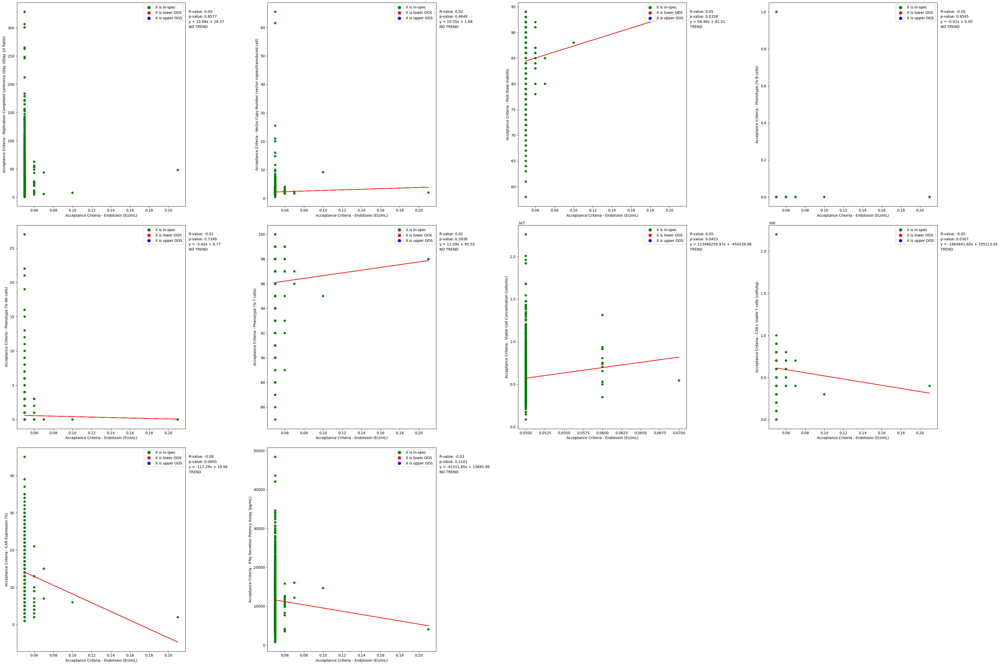

Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)


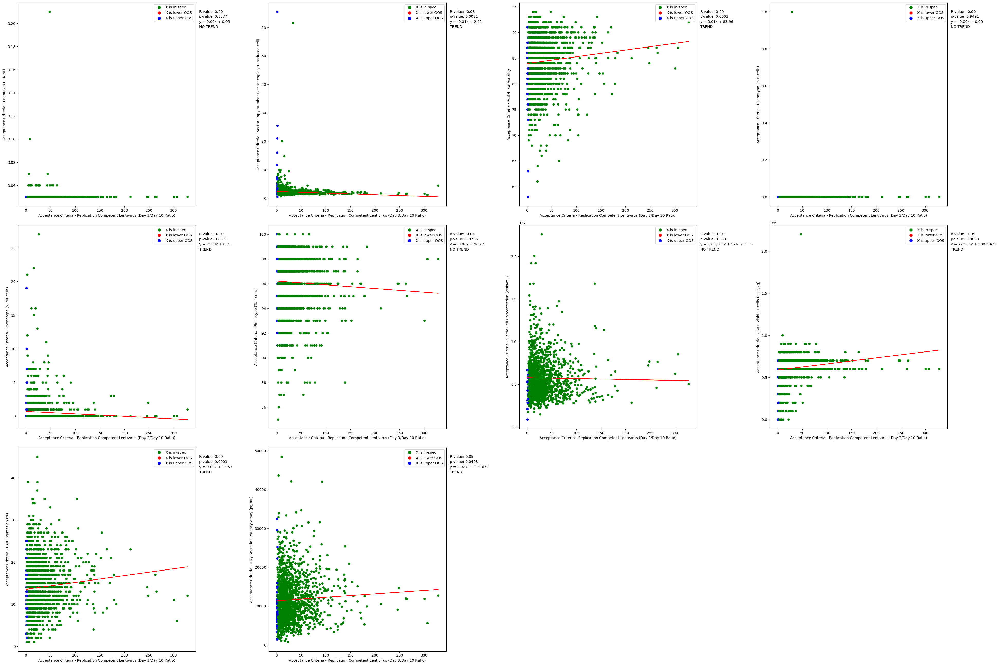

Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)


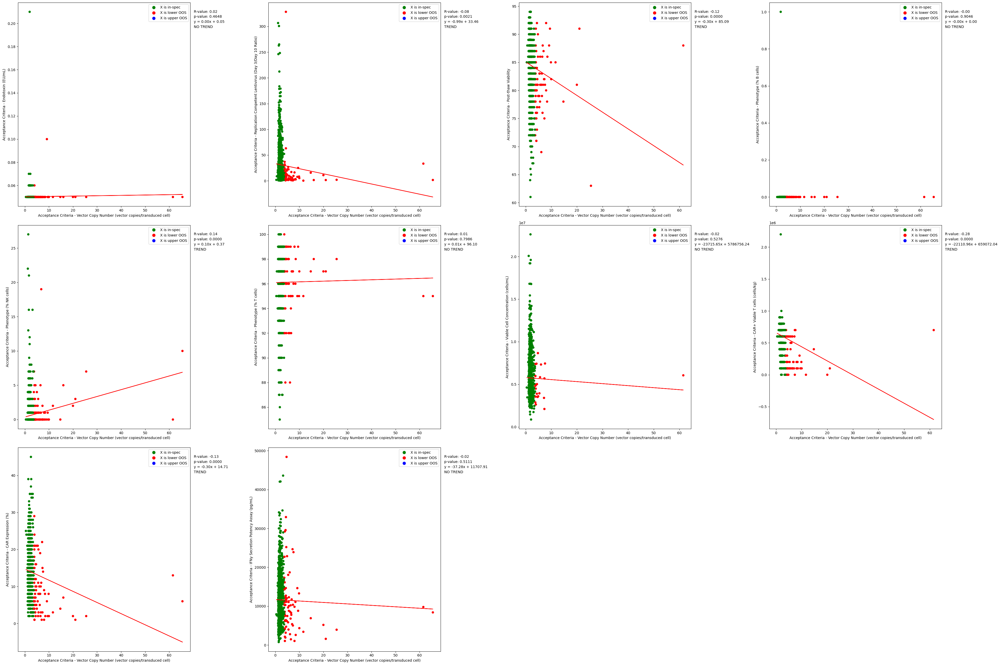

Acceptance Criteria - Post-thaw Viability


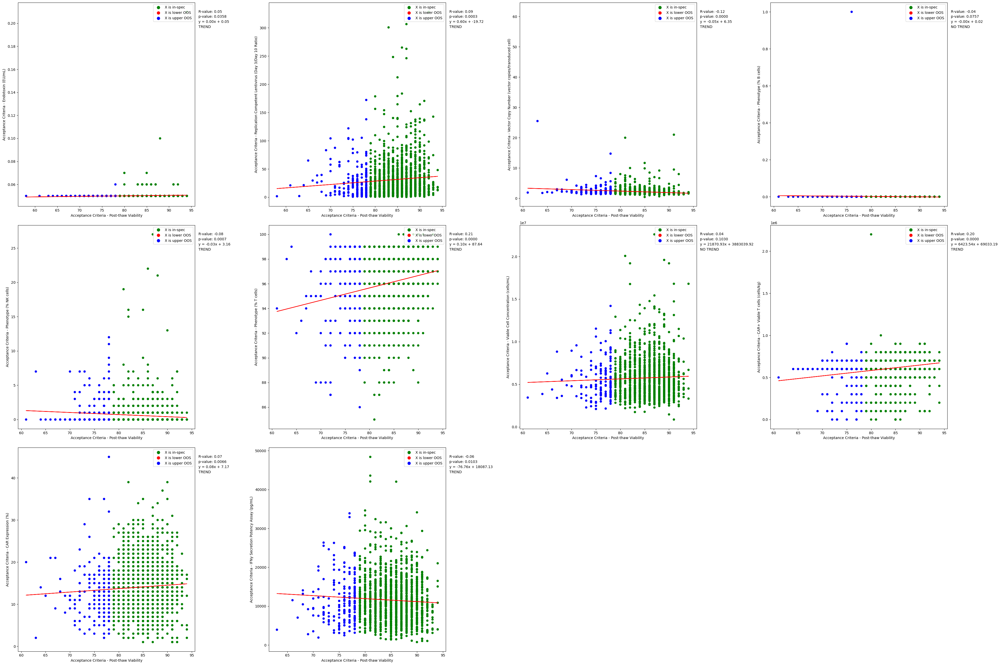

Acceptance Criteria - Phenotype (% B cells)


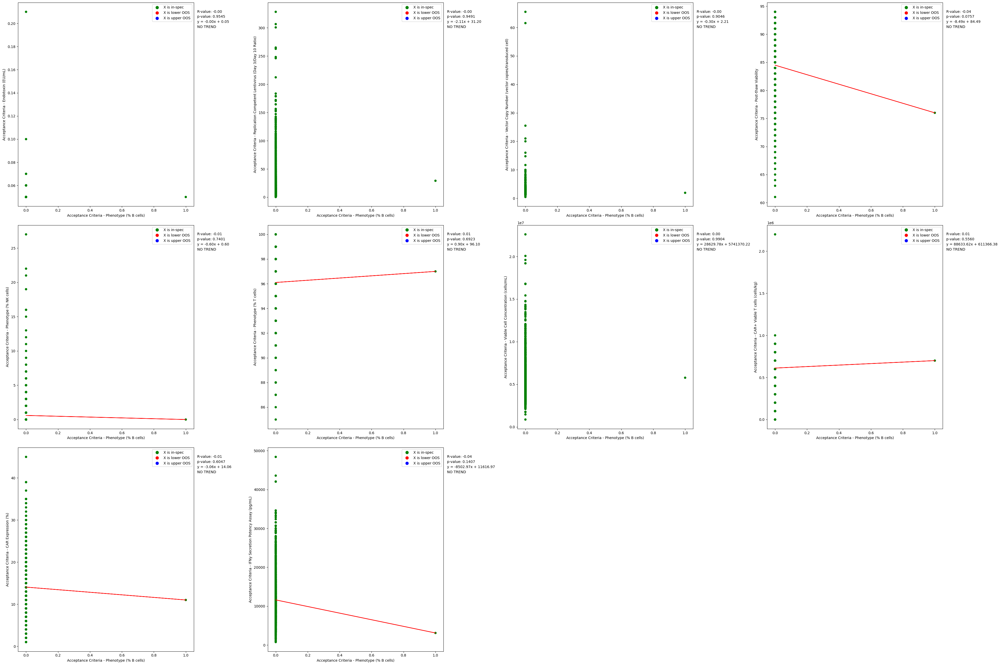

Acceptance Criteria - Phenotype (% NK cells)


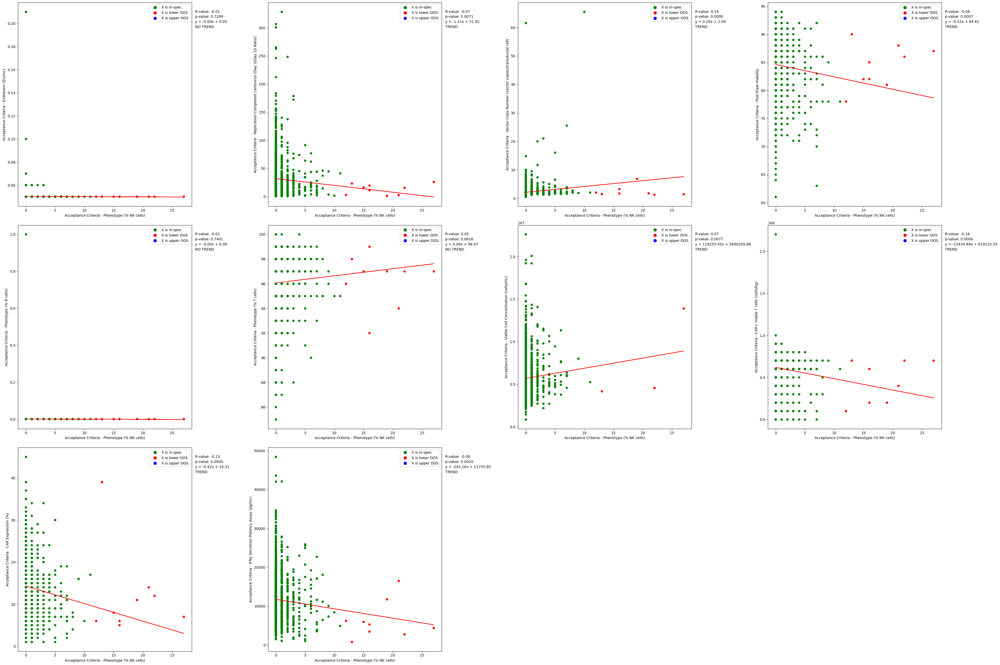

Acceptance Criteria - Phenotype (% T cells)


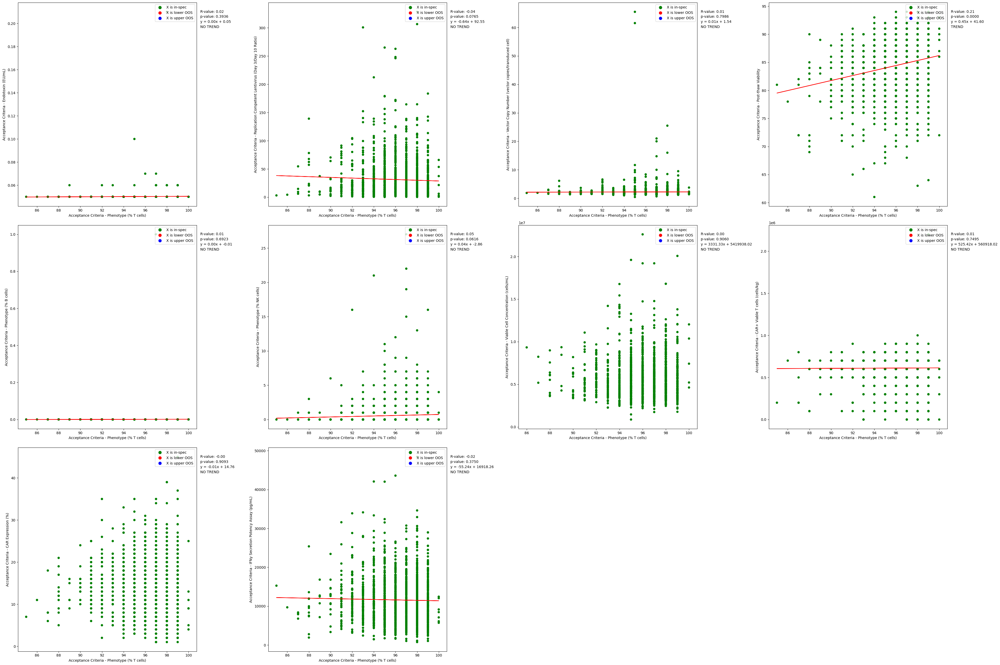

Acceptance Criteria - Viable Cell Concentration (cells/mL)


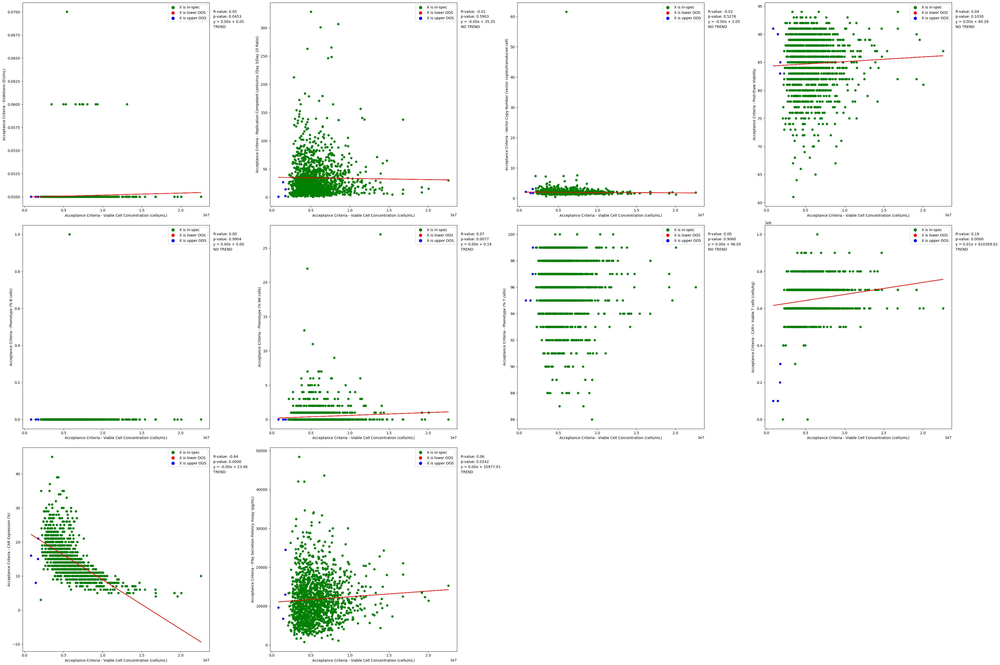

Acceptance Criteria - CAR+ Viable T cells (cells/kg)


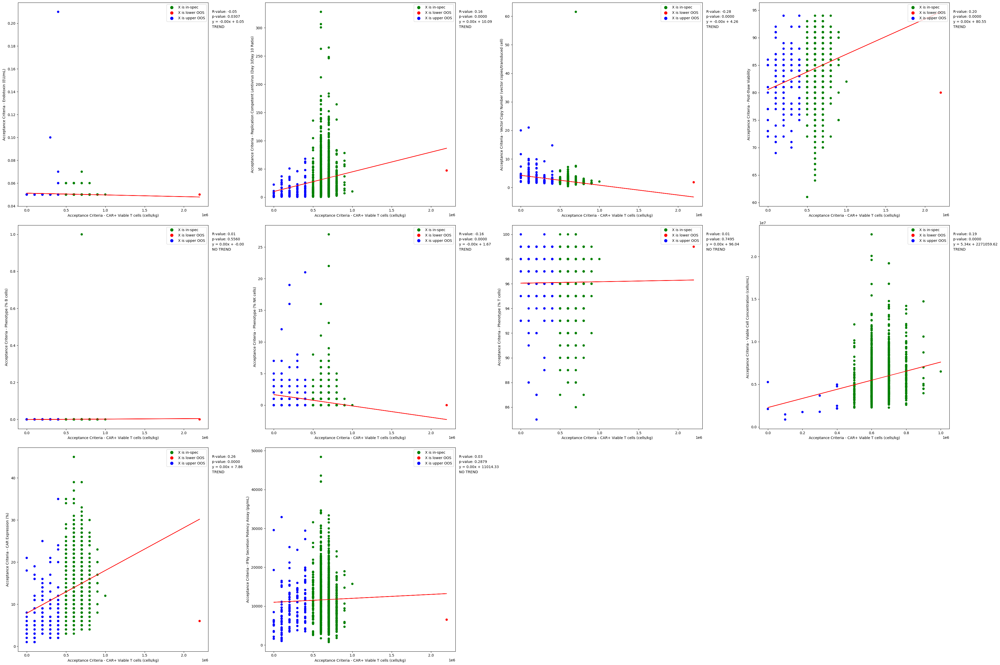

Acceptance Criteria - CAR Expression (%)


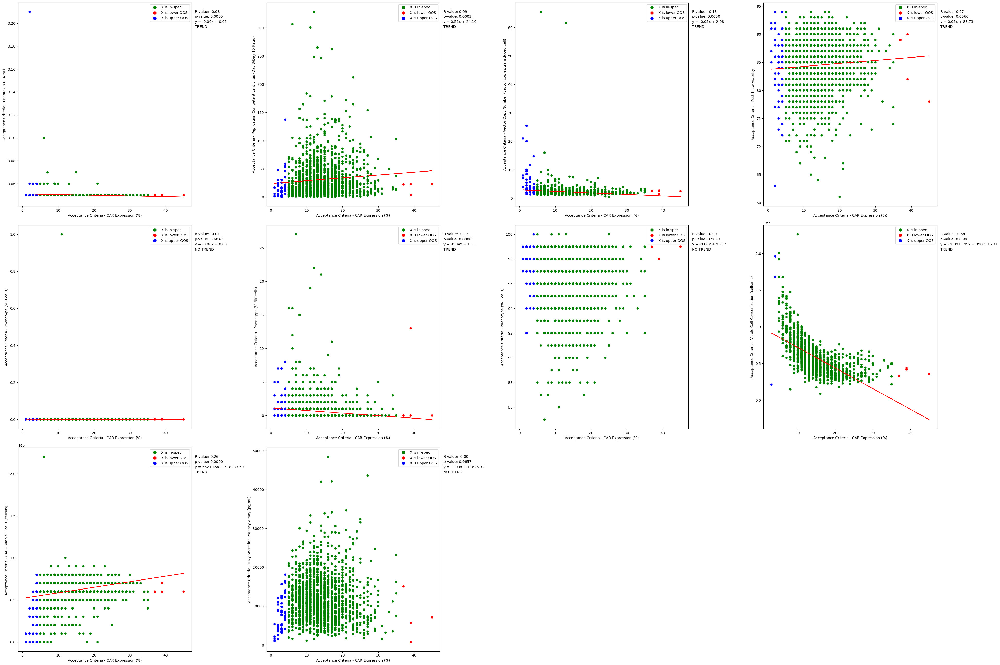

Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)


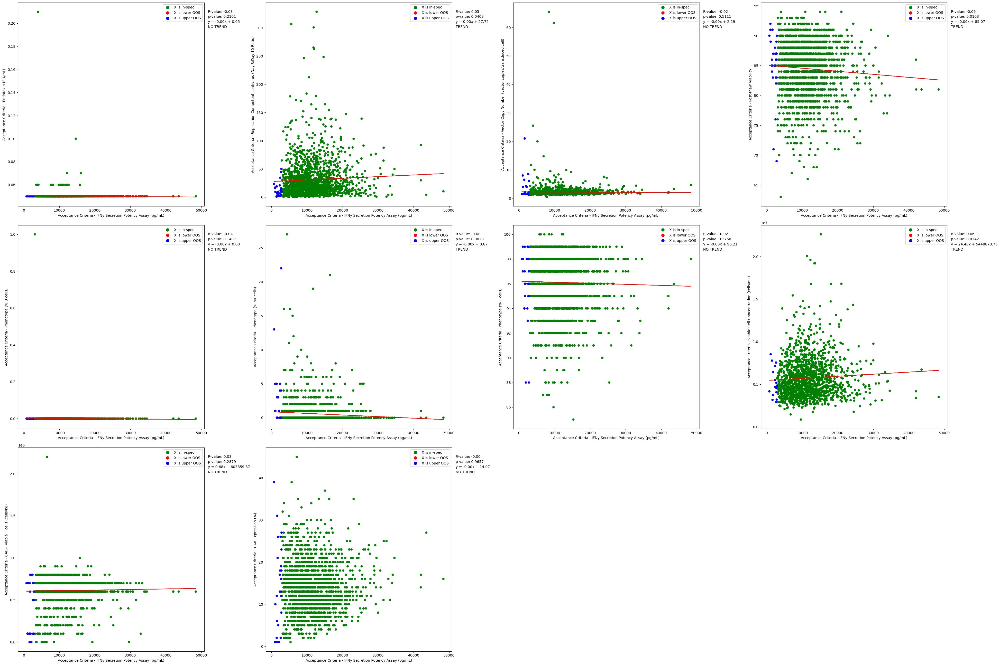

In [18]:
sub_dir = 'Multi_Variate_Analysis_of_Acceptance_Criteria'
for i, x_col in enumerate(cols):   # X-COLUMN INDEXER
  print(x_col)

  # Each subplot is with respect to the same X Column
  plt.figure(figsize=(39, 26))
  X_floor, X_ceil = spec[x_col][0], spec[x_col][3]   # <100kg  X-Thresholds

  graph_counter = 0 # Graph Position
  for j, y_col in enumerate(cols): # Y-COLUMN Indexer
    if i==j:    # Skip identity plots
      continue
    else:
      graph_counter+=1

    ###### Get Y upper/lower limit ######
    Y_ceil,   Y_floor = spec[y_col][0], spec[y_col][3]   # <100kg  X-Thresholds

    ## Inspec & OOS - All X/Y pairs where BOTH X/Y do not have NaNs, Nones,
    subset = df[(df[x_col].notna() & df[x_col].ne('') & df[x_col].ne(None)) &
                (df[y_col].notna() & df[y_col].ne('') & df[y_col].ne(None))]

    x, y = subset[x_col].values, subset[y_col].values
     # Exponential Relationship
    # if (x_col == 'Acceptance Criteria - CAR Expression (%)' and y_col =='Acceptance Criteria - Viable Cell Concentration (cells/mL)') or \
    # (y_col == 'Acceptance Criteria - CAR Expression (%)' and x_col =='Acceptance Criteria - Viable Cell Concentration (cells/mL)') :
    #   print(col)
    #   x, y = np.log(subset[x_col]), np.log(subset[y_col])
    #   print(subset[x_col].values)
    #   print(np.log(subset[x_col]))
      # result = list(zip(np.log(subset[x_col]), np.log(subset[y_col])))

    # Critiria 1 - Within Spec
    if not math.isnan(X_ceil) and not math.isnan(X_ceil):
      cond1 = (x>=X_floor) & (x<=X_ceil)
    elif math.isnan(X_floor):
      cond1 = (x<=X_ceil)
    elif math.isnan(X_ceil):
      cond1 = (x>=X_floor)
    # Criteria 2 - Greater than Spec
    cond2 = (x>X_ceil)
    # Criteria 3 - Below Spec
    cond3 = (x<X_floor)

    # Use numpy.select to assign colors based on conditions
    conditions = [cond1, cond2, cond3]
    colors_choices = ['green', 'red', 'blue']
    color_meanings = ['X is in-spec', 'X is lower OOS', 'X is upper OOS']
    colors = np.select(conditions, colors_choices)

    # Plot & Labels
    plt.subplot(3, 4, graph_counter)
    plt.scatter(x, y, c=colors, s=30, alpha = 1)
    # plt.title(f"Chart {j} for Figure {i}")
    plt.xlabel(x_col)
    plt.ylabel(y_col)

    # Calculate the line of best fit
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    best_fit = slope * x + intercept
    if round(r_value,2)!=0:   # Only plot those with correlation
      plt.plot(x, best_fit, color='red', label='Line of Best Fit')

    # Fitting exponential model
    # params_exp, _ = curve_fit(exponential, x, y)
    # predicted_exp = exponential(x, *params_exp)

    # r2_exp = r2_score(y, predicted_exp)
    # print(f"R^2 (exponential): {r2_exp}")

    # if round(r2_exp,2)> 0:
    #   pass
    # Plotting the exponential fit
      # plt.plot(x, predicted_exp, label='Exponential Fit', color='blue')

    # Add captions with R-value, p-value, and the linear equation
    plt.text(1.02, 0.95, 'R-value: {:.2f}'.format(r_value), transform=plt.gca().transAxes)
    plt.text(1.02, 0.925, 'p-value: {:.4f}'.format(p_value), transform=plt.gca().transAxes)
    plt.text(1.02, 0.9, 'y = {:.2f}x + {:.2f}'.format(slope, intercept), transform=plt.gca().transAxes)

    # Trend or no Trend based on P-value
    if p_value <=0.05:
      plt.text(1.02, 0.875, 'TREND', transform=plt.gca().transAxes)
    else:
      plt.text(1.02, 0.875, 'NO TREND', transform=plt.gca().transAxes)

    legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=meaning) for color, meaning in zip(colors_choices, color_meanings)]
    plt.legend(handles=legend_elements, loc='upper right')

  # Save the figure with a unique name
  plt.tight_layout()  # Adjust layout for clarity

  x_col_replaced = re.sub(r'[\(\)/]', '_', x_col) # replace characters that interfere with saving file
  file_path = os.path.join(dir_name, sub_dir, f'{x_col_replaced}_vs.All_Y.png')
  plt.savefig(file_path)

  plt.show()




## Same Scatter plot but with more conditions (NOT USED)

In [19]:
# # Calculate number of rows needed
# ncols = len(cols)
# n_subplots = len(data_list)
# nrows = -(-n_subplots // ncols)  # Calculates the ceiling of n_subplots / ncols

# # Create figure and subplot grid
# fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(64, 64))

# # Flatten axes for easier iteration
# if nrows == 1 or ncols == 1:
#     axes = axes.flatten()
# else:
#     axes = axes.reshape(-1)

# # Loop through subplots and add data
# for i, (ax, title, x_col, y_col) in enumerate(zip(axes, titles, x_labels, y_labels)):
#     if i < n_subplots:
#         x, y = zip(*data_list[i]) # Unpack TUple

#         X_floor_under_100kg, X_ceil_under_100kg = spec[x_col][0], spec[x_col][3]   # <100kg  X-Thresholds
#         X_floor_over_100kg,  X_ceil_over_100kg  = spec[x_col][1], spec[x_col][2]   # >100kg  X-Thresholds
#         Y_floor_under_100kg, Y_ceil_under_100kg = spec[y_col][0], spec[y_col][3]   # <100kg  X-Thresholds
#         Y_floor_over_100kg,  Y_ceil_over_100kg  = spec[y_col][1], spec[y_col][2]   # >100kg  X-Thresholds

#         # Get in-spec and OOS INDEXES
#         # X_inspec_criteria = (df[x_col]<=X_ceil_under_100kg) & (df[x_col]>=X_floor_under_100kg)
#         # X_OOS_criteria =    (df[x_col]> X_ceil_under_100kg) | (df[x_col] <X_floor_under_100kg)
#         # Y_inspec_criteria = (df[y_col]<=Y_ceil_under_100kg) & (df[y_col]>=Y_floor_under_100kg)
#         # Y_OOS_criteria =    (df[y_col]> Y_ceil_under_100kg) | (df[y_col] <Y_floor_under_100kg)

#         # # X values
#         # x1_inspec = df[inspec_criteria][x_col].values
#         # x2_OOS = df[OOS_criteria][x_col].values

#         # colors = np.where(((x>X_floor_under_100kg) & (x<X_ceil_under_100kg) &
#         #                   (y>Y_floor_under_100kg) & (y<Y_ceil_under_100kg)), 'green', 'red')

#         # Critiria 1 - X/Y INSPEC - GREEN
#         cond1 = (x>=X_floor_under_100kg) & (x<=X_ceil_under_100kg) & \
#                 (y>=Y_floor_under_100kg) & (y<=Y_ceil_under_100kg)
#         ######### X/Y BOTH OOS
#         # Criteria 2 - OOS UPPER for X/Y - RED
#         cond2 = (x>X_ceil_under_100kg)  & (y>Y_ceil_under_100kg)
#         # Criteria 3 - OOS lower for X/Y - RED
#         cond3 = (x<X_floor_under_100kg) & (y<Y_floor_under_100kg)


#         # Criteria 4 - OOS UPPER for X and OOS LOWER for Y - PURPLE
#         cond4 = (x>X_ceil_under_100kg)  & (y>Y_ceil_under_100kg)
#         # Criteria 5 - OOS LOWER for X and OOS UPPER for Y - ORANGE
#         cond5 = (x<X_floor_under_100kg) & (y<Y_floor_under_100kg)

#         ######### X OOS and Y-inspec
#         # Criteria 6 - OOS lower for X and Y in-spec - ##ADD8E6 (Light Blue)
#         cond6 = (x<X_floor_under_100kg) & (y>=Y_floor_under_100kg) & (y<=Y_ceil_under_100kg)
#         # Criteria 7 - OOS upper for X and Y in-spec.  # #ffcccb(Light Red)
#         cond7 = (x>X_ceil_under_100kg) & (y>=Y_floor_under_100kg) & (y<=Y_ceil_under_100kg)

#         ######### Y OOS & X in-spec
#         # Criteria 8 - X-inspec and Y OOS upper - BLUE
#         cond8 = (x>=X_floor_under_100kg) & (x<=X_ceil_under_100kg) & (y>Y_ceil_under_100kg)
#         # Criteria 9 - OOS upper for X and Y in-spec
#         cond9 = (x>X_ceil_under_100kg) & (y<=Y_ceil_under_100kg) & (y>=Y_floor_under_100kg)

#         # Use numpy.select to assign colors based on conditions
#         conditions = [cond1, cond2, cond3, cond4, cond5, cond6, cond7, cond8, cond9]
#         colors_choices = ['green', '#8B0000', '#00008B', 'purple','orange', '#ADD8E6', '#ffcccb', 'blue', 'red']
#         colors = np.select(conditions, colors_choices)

#         # Create the scatter plot
#         ax.scatter(x, y, c=colors, s=10, alpha = 0.3)


#         # Visually compact
#         ax.set_title(f'Graph {i + 1}')
#         ax.set_xlabel(x_col)
#         ax.set_ylabel(y_col)

#     else:
#         ax.axis('off')  # Turn off extra subplots

#         # Auto-adjust layout to prevent overlap
# plt.tight_layout()
# plt.show()

# **Acceptance Criteria Manufacturing Trends**

In [20]:
# Create Subdirectory
sub_dir = 'Acceptance_Criteria_Manufacturing_Trends'
if not os.path.exists(os.path.join(dir_name, sub_dir)):
  os.makedirs(os.path.join(dir_name, sub_dir))

In [21]:
# Deal with non Float numbers
cols = ['Date of Manufacture Start',
        'Acceptance Criteria - Endotoxin (EU/mL)',
        'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)',
        'Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)',
        'Acceptance Criteria - Post-thaw Viability',
        'Acceptance Criteria - Phenotype (% B cells)',
        'Acceptance Criteria - Phenotype (% NK cells)',
        'Acceptance Criteria - Phenotype (% T cells)',
        'Acceptance Criteria - Viable Cell Concentration (cells/mL)',
        'Acceptance Criteria - CAR+ Viable T cells (cells/kg)',
        'Acceptance Criteria - CAR Expression (%)',
        'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)']

df2 = df[cols]
df2['Date of Manufacture Start'] = pd.to_datetime(df2['Date of Manufacture Start'])
df2['Date of Manufacture Start (Quarter)'] = df2['Date of Manufacture Start'].dt.to_period('Q')

# Sort the DataFrame by the 'Date' column
df2 = df2.sort_values(by='Date of Manufacture Start', ascending=True)

# Reset the index
df2.reset_index(drop=True, inplace=True)

/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/3760260407.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Date of Manufacture Start'] = pd.to_datetime(df2['Date of Manufacture Start'])
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/3760260407.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Date of Manufacture Start (Quarter)'] = df2['Date of Manufacture Start'].dt.to_period('Q')


## **Trend Plots**

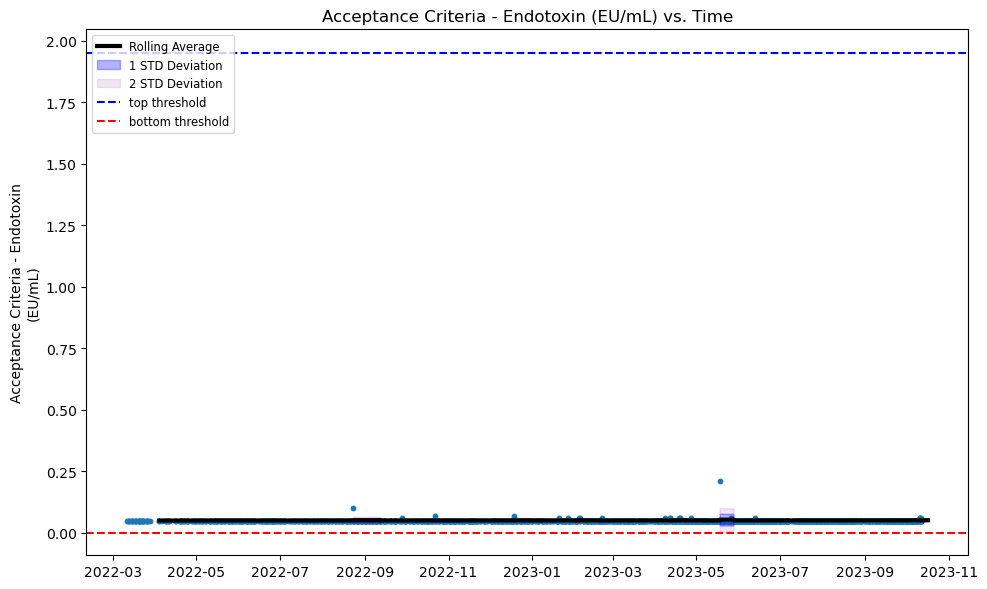

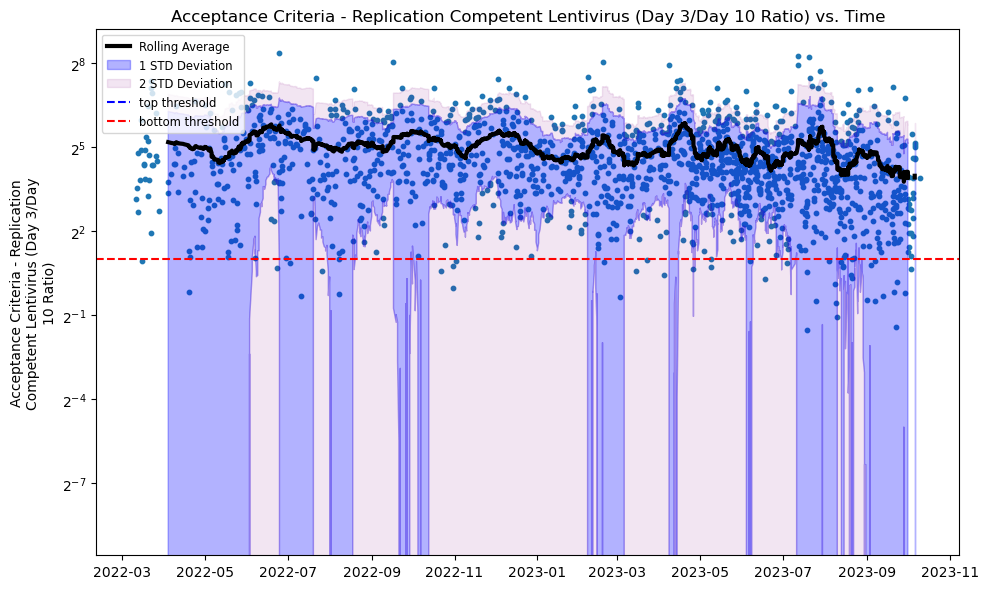

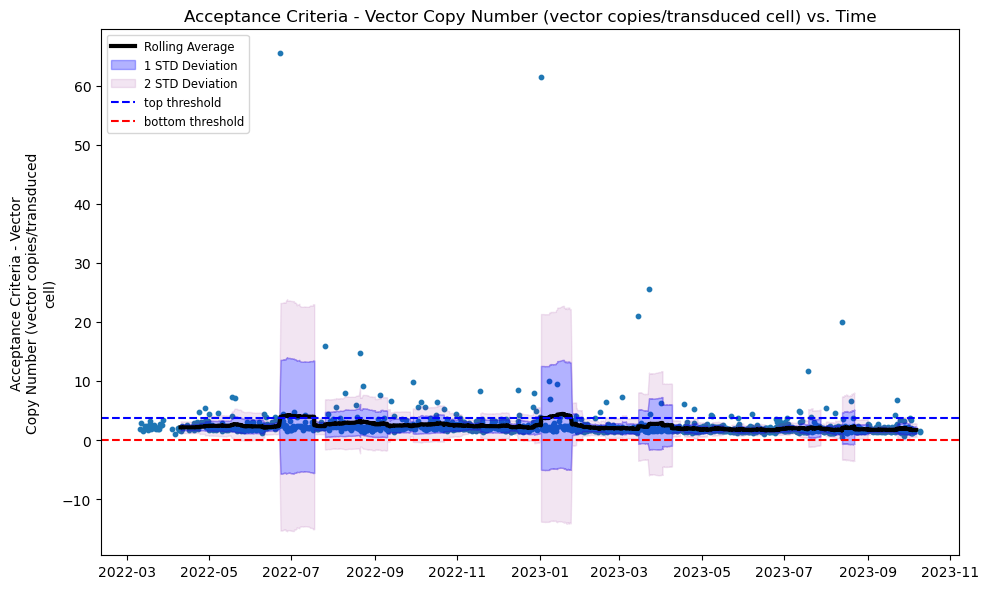

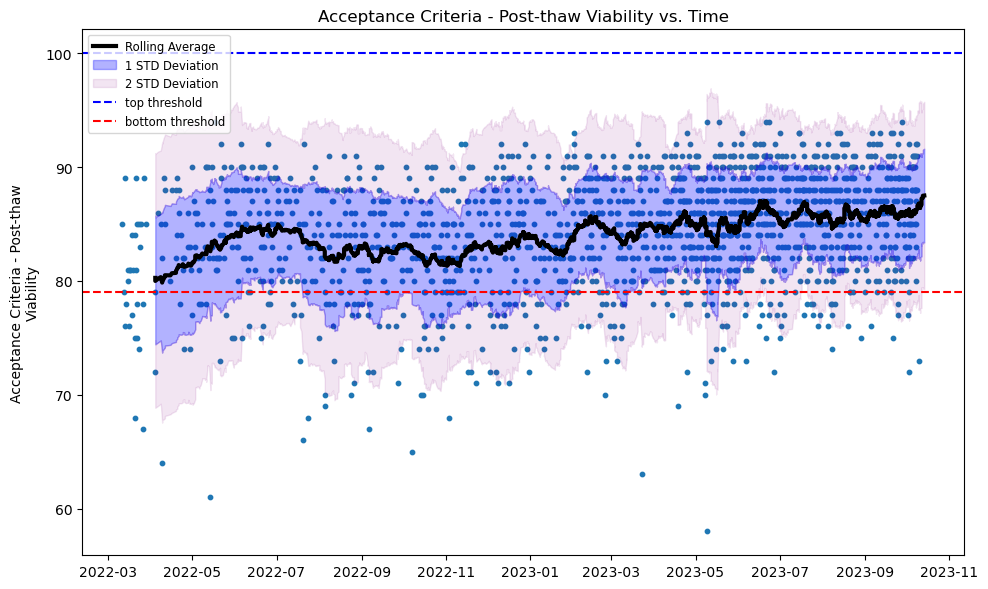

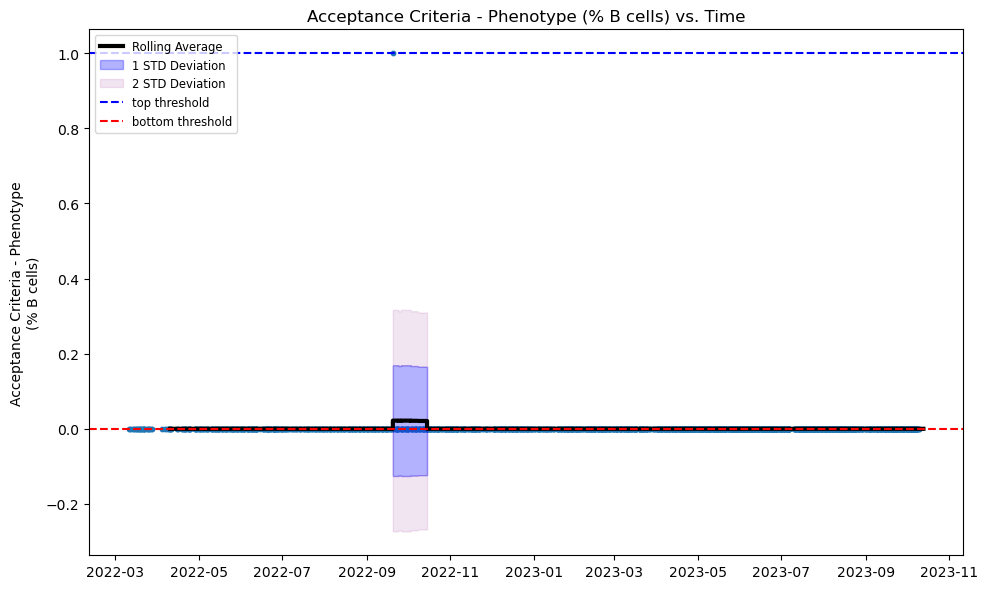

...

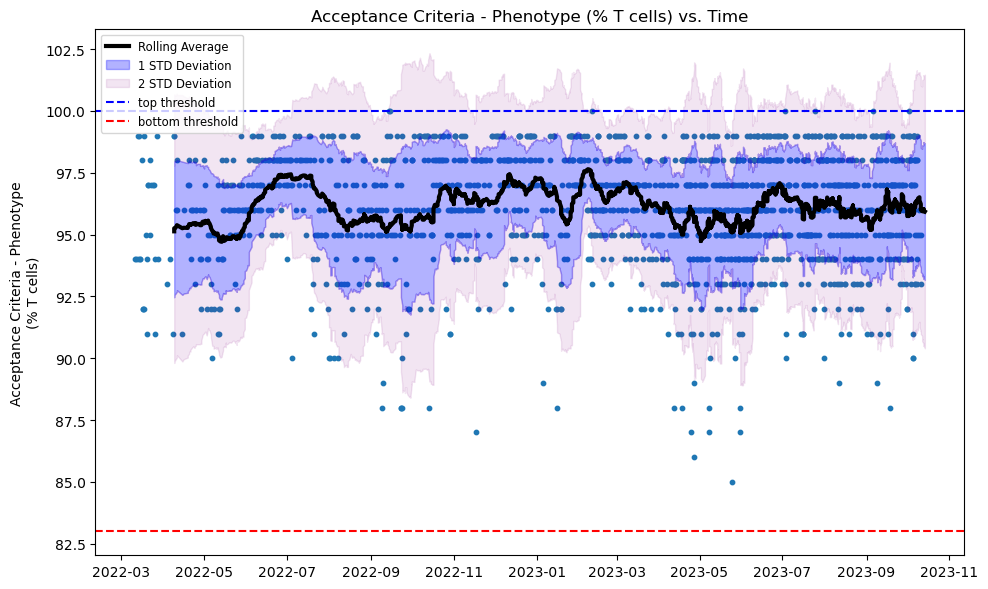

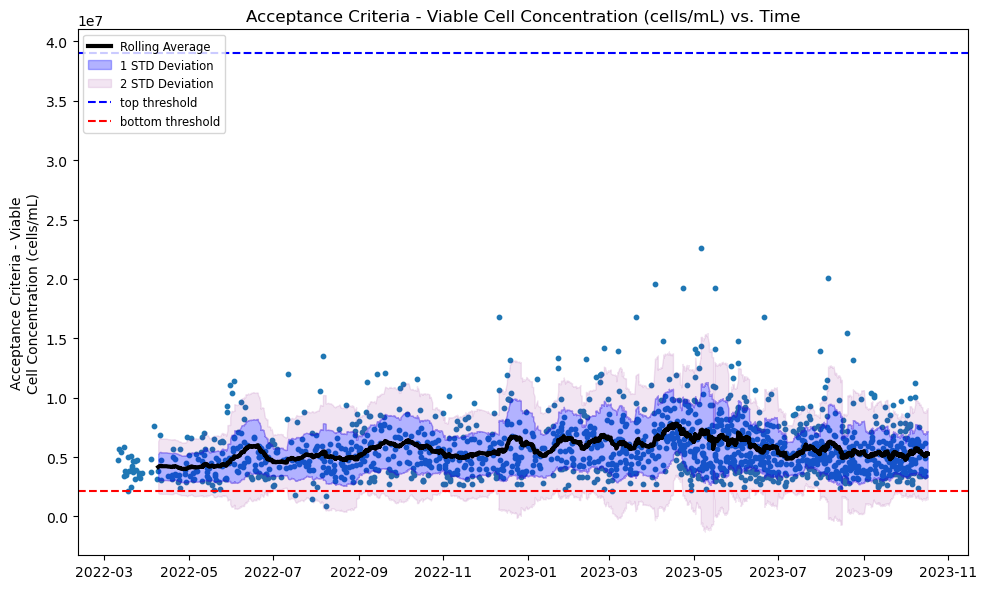

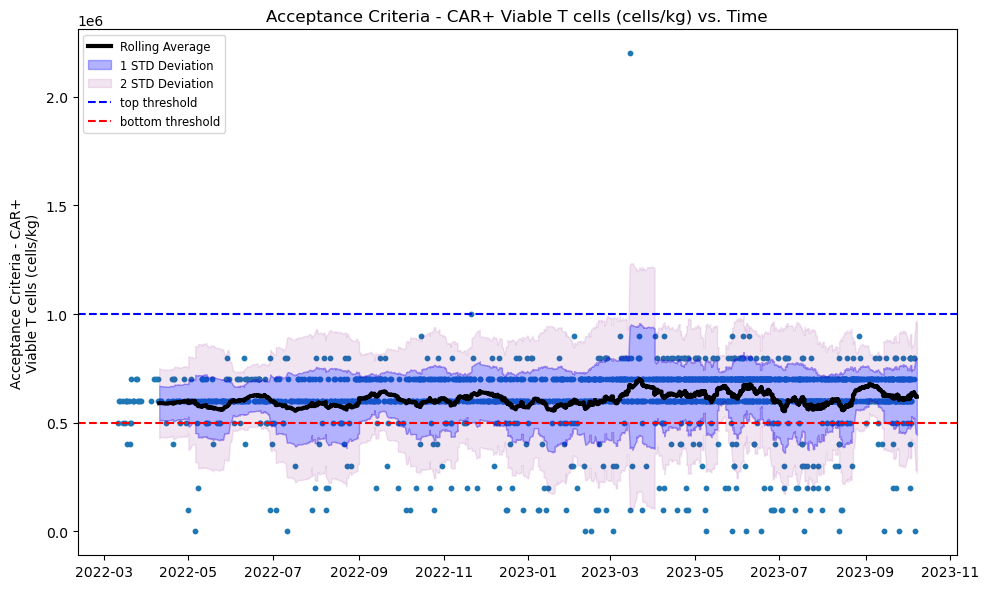

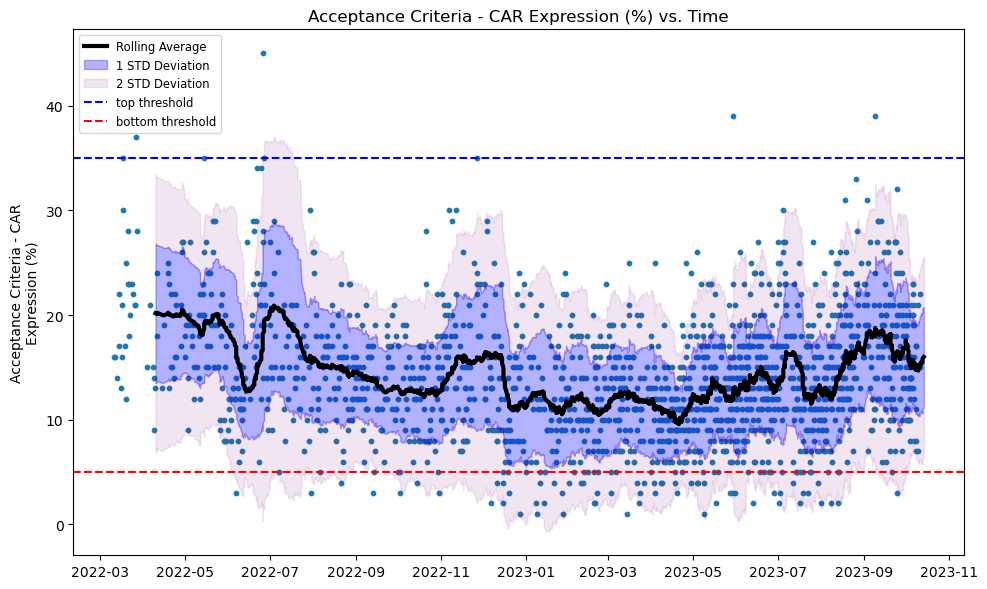

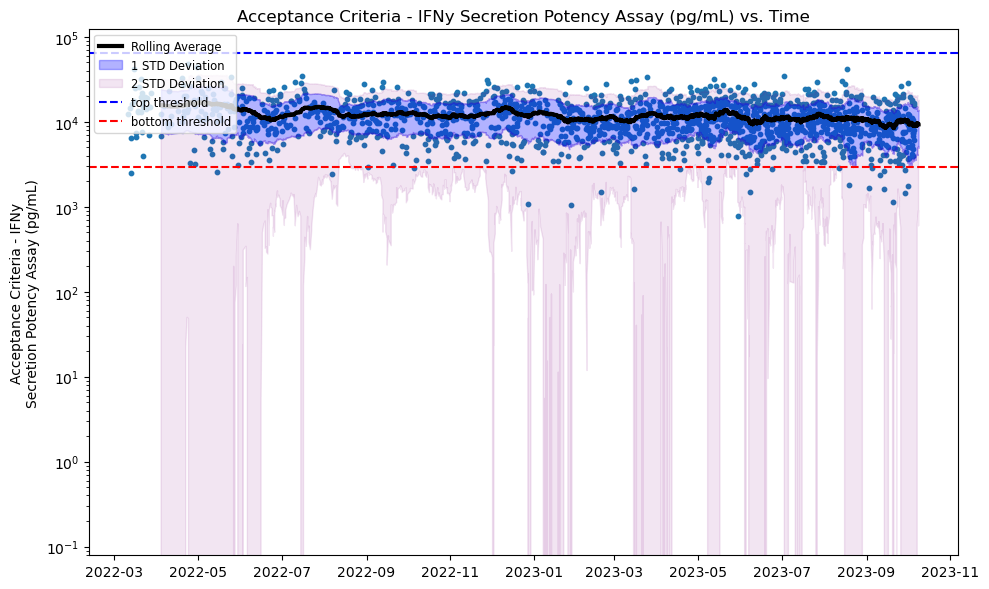

In [22]:
# Create Subdirectory
sub_dir_2 = 'Trend_Plots'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))

win = 30
for i, col in enumerate(cols[1:]):
    fig = plt.figure(figsize=(10, 6))

    # Scatter plot
    plt.scatter(df2['Date of Manufacture Start'], df2[col], s=10)

    # Calculate the rolling average with a window size of 50 and min_periods of 30
    df2['Rolling_Avg'] = df2[col].rolling(window=50, min_periods=30).mean()
    df2['Rolling_Std'] = df2[col].rolling(window=50, min_periods=30).std()

    # Plot the rolling average
    plt.plot(df2['Date of Manufacture Start'], df2['Rolling_Avg'], color='black', label='Rolling Average', lw=3)

    # Adding the 1SD band
    plt.fill_between(df2['Date of Manufacture Start'],
                    df2['Rolling_Avg'] - df2['Rolling_Std'],
                    df2['Rolling_Avg'] + df2['Rolling_Std'],
                    color='blue', alpha=0.3, label='1 STD Deviation')

    # Adding the Upper 2SD band
    plt.fill_between(df2['Date of Manufacture Start'],
                    df2['Rolling_Avg'] + df2['Rolling_Std'],
                    df2['Rolling_Avg'] + 2 * df2['Rolling_Std'],
                    color='purple', alpha=0.1, label='2 STD Deviation')

    # Adding the Lower 2SD band
    plt.fill_between(df2['Date of Manufacture Start'],
                    df2['Rolling_Avg'] - df2['Rolling_Std'],
                    df2['Rolling_Avg'] - 2 * df2['Rolling_Std'],
                    color='purple', alpha=0.1)  # , label='2 STD Deviation') # None

    # Add threshold lines
    X_floor_under_100kg, X_ceil_under_100kg = spec[col][0], spec[col][3]  # >100kg  X-Thresholds
    plt.axhline(y=X_ceil_under_100kg, color='b', linestyle='--', label='top threshold')
    plt.axhline(y=X_floor_under_100kg, color='r', linestyle='--', label='bottom threshold')

    # Adding title and labels
    plt.title(f'{col} vs. Time')
    # Insert /n for axis
    def insert_newlines(label):
        words = label.split()
        grouped_words = [' '.join(words[i:i+4]) for i in range(0, len(words), 4)]
        return '\n'.join(grouped_words)
    #
    plt.ylabel(insert_newlines(col))
    plt.legend(fontsize='small', loc='upper left')

    # Use Log base 2 for these graphs
    if col == 'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)':
        plt.yscale('log', base=2)
    if col == 'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)':
        plt.yscale('log', base=10)

    plt.tight_layout()
    plt.show()

    # Save Trend Plot
    col_replaced = re.sub(r'[\(\)/]', '_', col) # replace characters that interfere with saving file
    fig.savefig(os.path.join(dir_name, sub_dir, sub_dir_2, f'{col_replaced}{i}.png'), dpi=300, bbox_inches='tight')



# **OOS Rate Plots**

/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/1202067972.py:26: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df2b = df2.groupby([df2['Date of Manufacture Start'].dt.date]).sum()
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/1202067972.py:76: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/1202067972.py:26: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df2b = df2.groupby([df2['Date of Manufacture Start'].dt

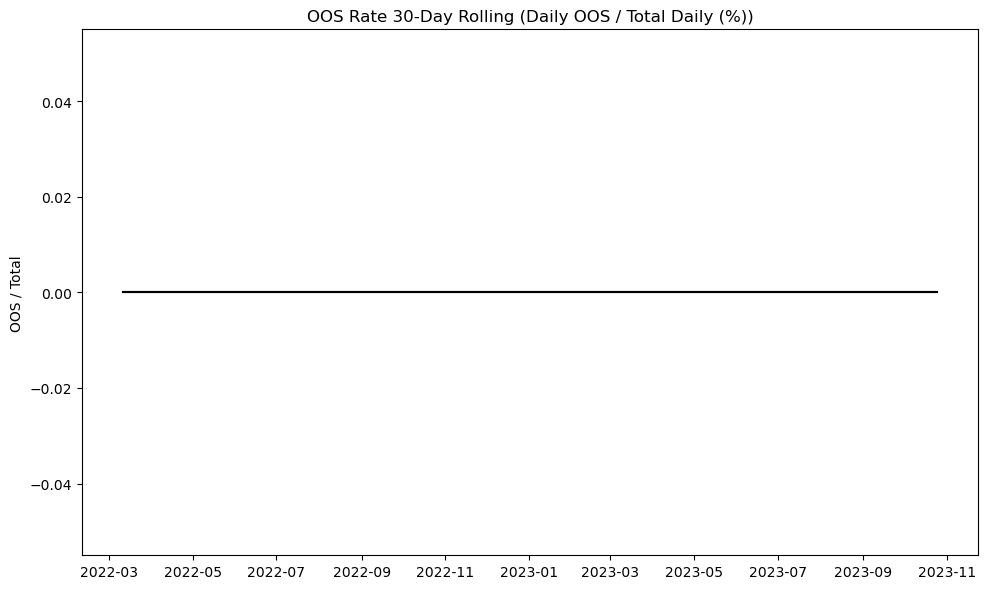

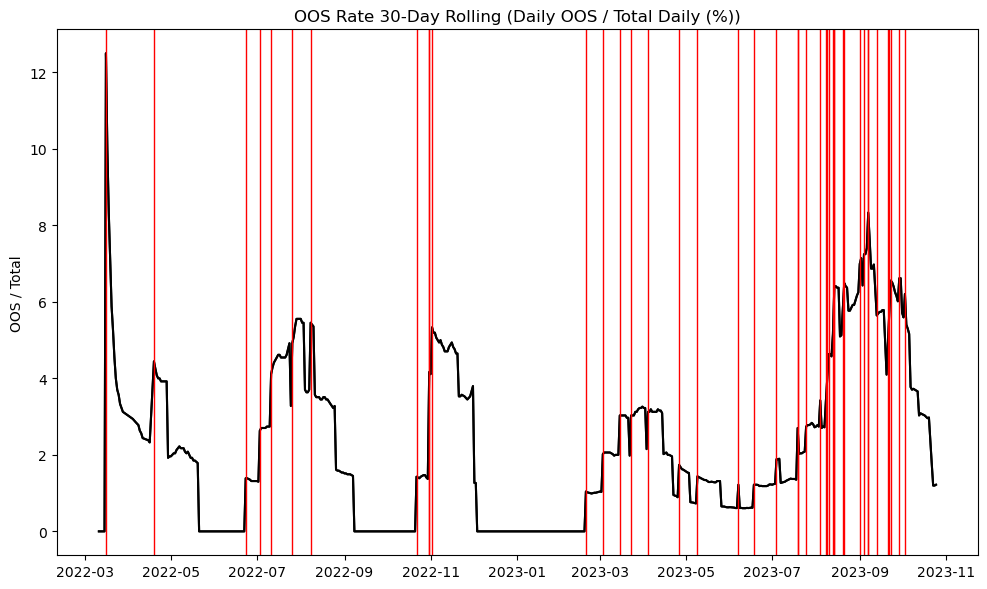

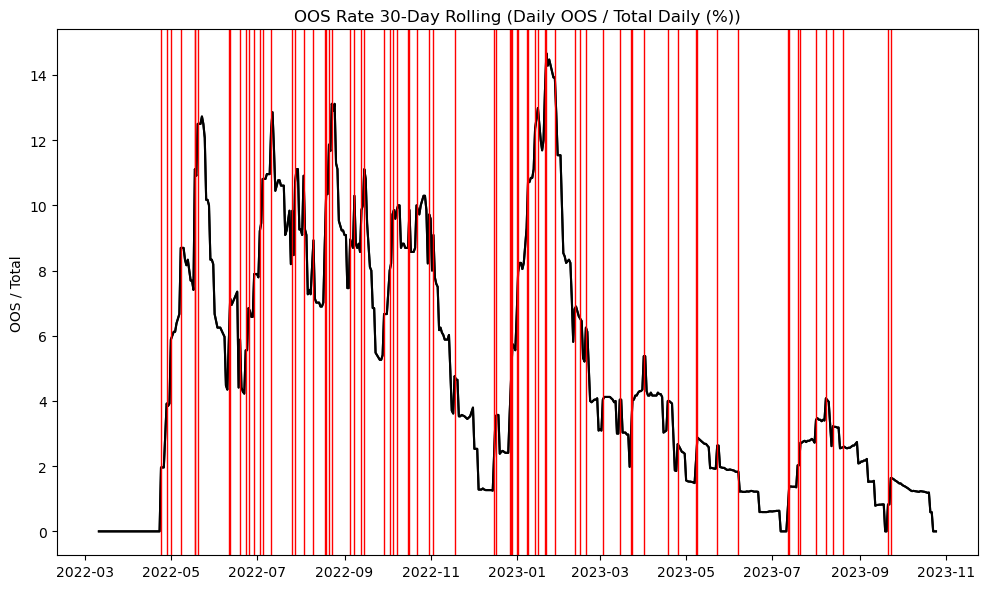

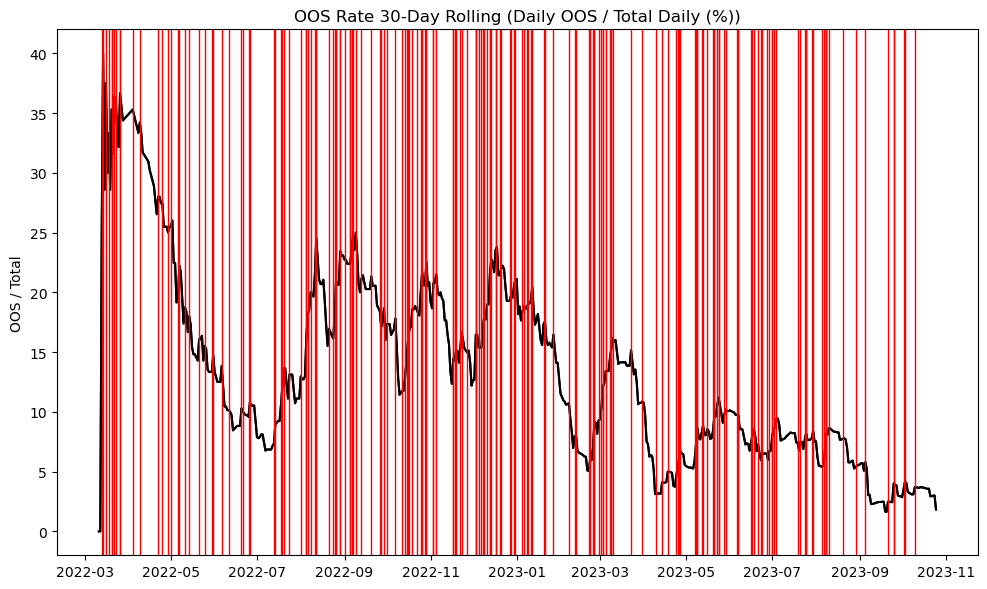

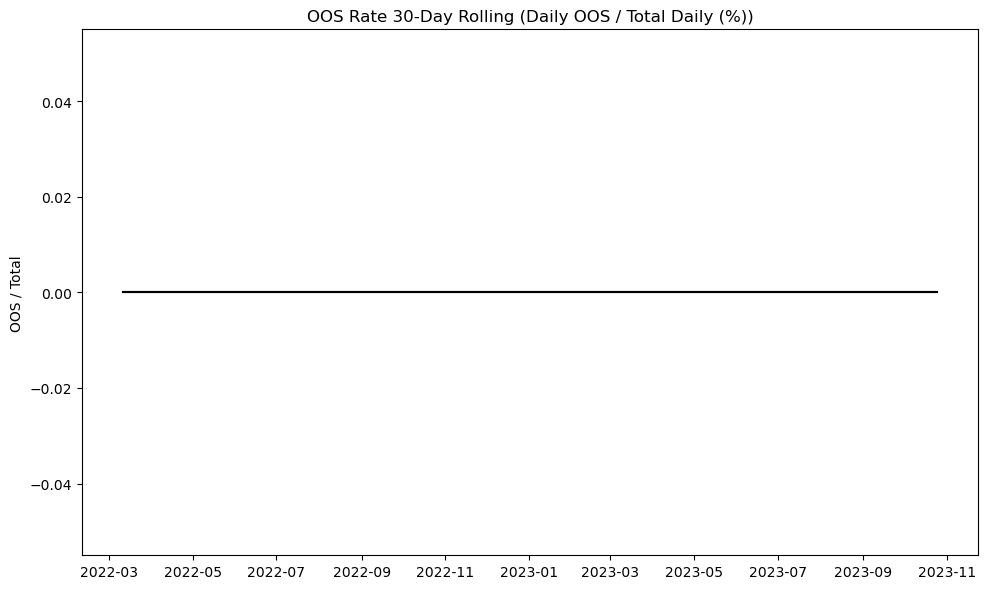

...

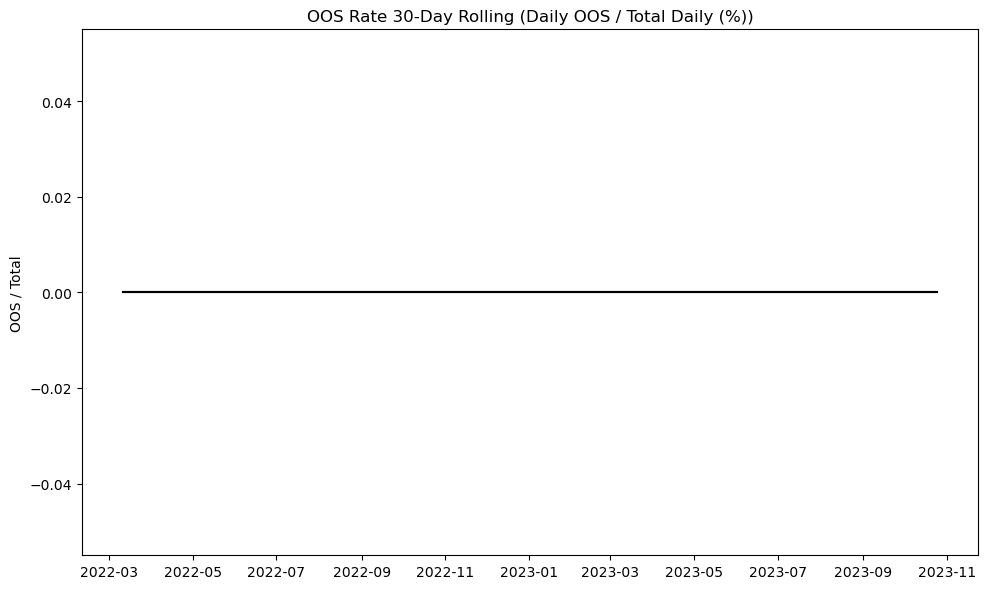

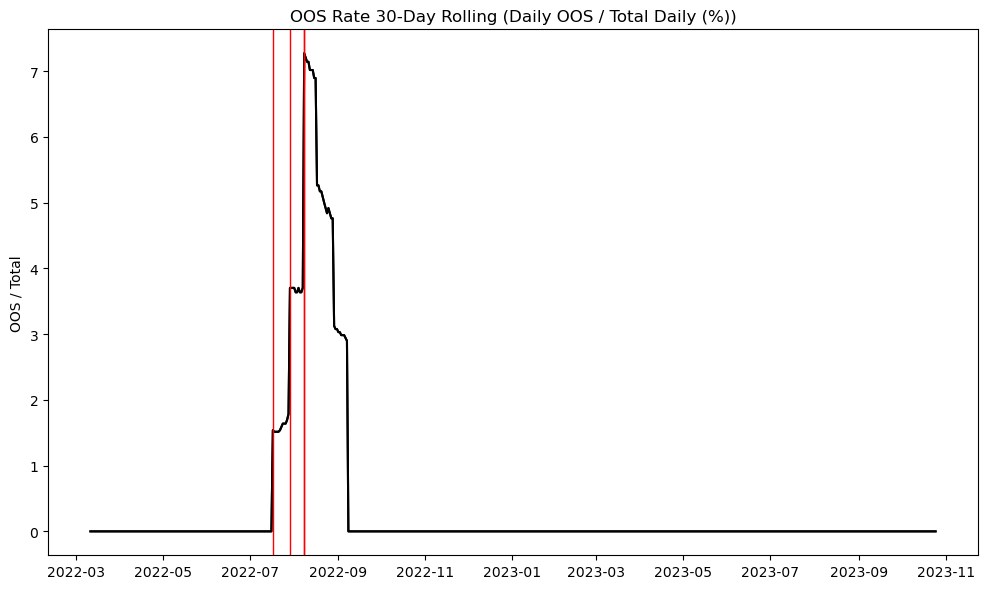

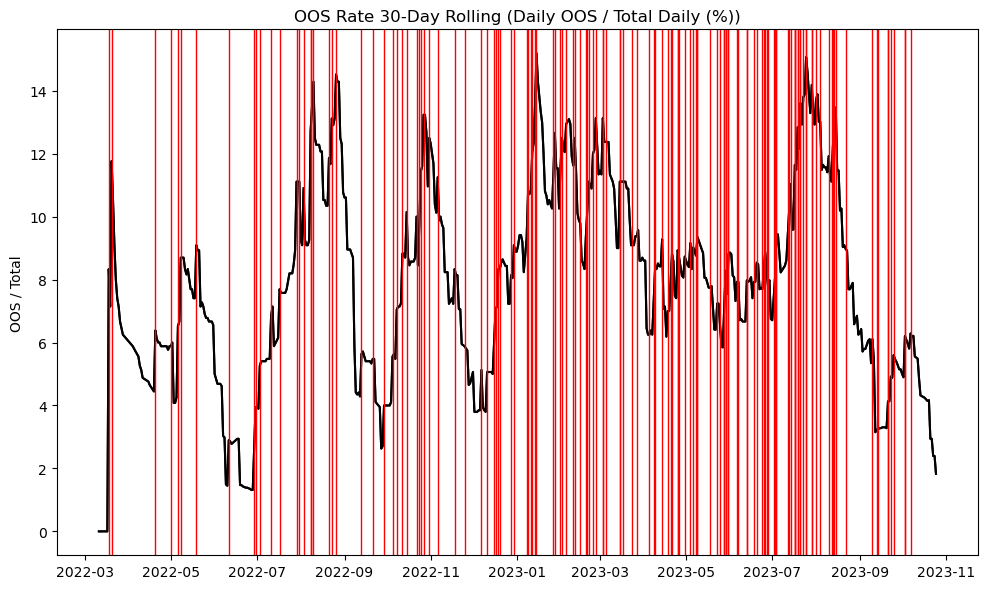

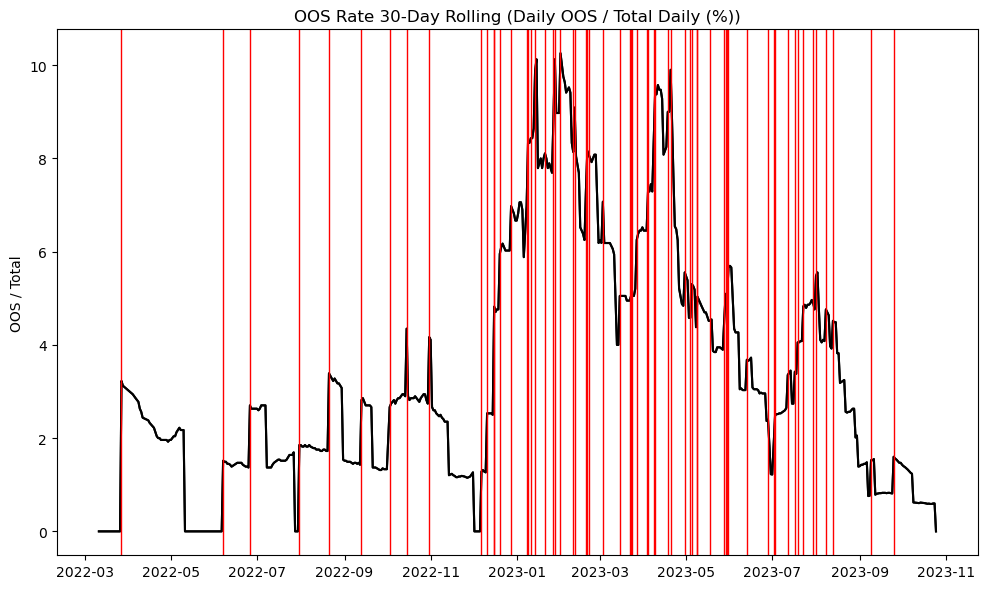

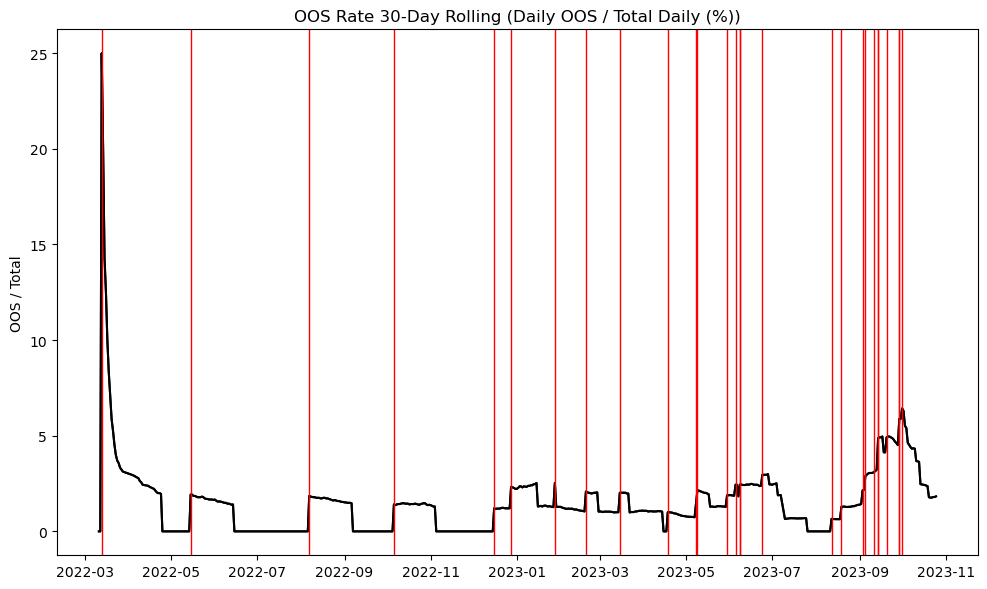

In [23]:
# Create Subdirectory
sub_dir_2 = 'OOS_Rate_Plots'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))

win = 30
for i, col in enumerate(cols[1:]):
    fig = plt.figure(figsize=(10, 6))

    # Calculate the rolling average with a window size of 50 and min_periods of 30
    df2['Rolling_Avg'] = df2[col].rolling(window=50, min_periods=30).mean()
    df2['Rolling_Std'] = df2[col].rolling(window=50, min_periods=30).std()

    # Add threshold lines
    X_floor_under_100kg, X_ceil_under_100kg = spec[col][0], spec[col][3]  # >100kg  X-Thresholds

    # Insert /n for axis
    def insert_newlines(label):
        words = label.split()
        grouped_words = [' '.join(words[i:i+4]) for i in range(0, len(words), 4)]
        return '\n'.join(grouped_words)


    # Add 'temp' to the second subplot and calculate rolling 5-day OOS average by Manufacture Start Date
    df2['temp'] = np.where((df2[col] < X_floor_under_100kg) | (df2[col] > X_ceil_under_100kg), 1, 0)
    df2b = df2.groupby([df2['Date of Manufacture Start'].dt.date]).sum()
    df2b['Count_per_Date'] = df2.groupby(df2['Date of Manufacture Start'].dt.date).size().values

    # Calculate rolling 5-day sums and counts
    df2b['rolling_OOS_Sum'] = df2b['temp'].rolling(window=win, min_periods=1).sum()
    df2b['rolling_Record_Count'] = df2b['Count_per_Date'].rolling(window=win, min_periods=1).sum()

    # Calculate rolling 5-day OOS percentage
    df2b['rolling_OOS_Percentage'] = (df2b['rolling_OOS_Sum'] / df2b['rolling_Record_Count'] * 100)

    # Plot the rolling OOS percentage by Manufacture Start Date
    plt.plot(df2b.index, df2b['rolling_OOS_Percentage'], ls='-', color='black')

    # Find peaks in daily_oos_percentage by comparing adjacent values
    peaks, _ = find_peaks(df2b['rolling_OOS_Percentage'], height=5)

#     # Get the dates and values of the peaks
#     peak_dates = df2b.index[peaks]
#     peak_values = df2b['rolling_OOS_Percentage'].iloc[peaks]

#     # Plot red vertical lines at the peak positions
#     for peak_date, peak_value in zip(peak_dates, peak_values):
#         axs[1].axvline(peak_date, color='red', linestyle='-', linewidth=1)

    OOS_indices = (df2[col] > X_ceil_under_100kg) | (df2[col] < X_floor_under_100kg)

    # Plot the rolling OOS percentage by Manufacture Start Date
    plt.plot(df2b.index, df2b['rolling_OOS_Percentage'], ls='-', color='black')

    # Plot red vertical lines for each OOS point in axs[0]
    for oos_index in df2.index[OOS_indices]:
        plt.axvline(x=df2['Date of Manufacture Start'].iloc[oos_index], color='red', linestyle='-', linewidth=1)

    # Adding title and labels to the second subplot
    plt.title(f'OOS Rate {str(win)}-Day Rolling (Daily OOS / Total Daily (%))')
    plt.ylabel('OOS / Total')

    # Change y-axis tickers to display percentages
    # plt.yticklabels(['{:.0f}%'.format(y) for y in axs[1].get_yticks()])

    inspec_criteria = (df2[col]<=X_ceil_under_100kg) & (df2[col]>=X_floor_under_100kg)
    OOS_criteria =    (df2[col]> X_ceil_under_100kg) | (df2[col] <X_floor_under_100kg)
    # X values (that does not include Nan)
    inspec = df2[inspec_criteria][col].values
    OOS = df2[OOS_criteria][col].values

    # Combined OOS Plot
    col_replaced = re.sub(r'[\(\)/]', '_', col) # replace characters that interfere with saving file
    fig.savefig(os.path.join(dir_name, sub_dir, sub_dir_2, f'{col_replaced}{i}.png'), dpi=300, bbox_inches='tight')
    fig.tight_layout()
    fig.show()



##  **COMBINED Trend and OOS PLots**




/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:66: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df2b = df2.groupby([df2['Date of Manufacture Start'].dt.date]).sum()
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:101: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs[1].set_yticklabels(['{:.0f}%'.format(y) for y in axs[1].get_yticks()])
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:133: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:66: FutureWarning: The default value of numeric_only in DataFrame

/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:133: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:66: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df2b = df2.groupby([df2['Date of Manufacture Start'].dt.date]).sum()
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:101: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs[1].set_yticklabels(['{:.0f}%'.format(y) for y in axs[1].get_yticks()])
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/368220333.py:133: UserWarning: Matplotlib is currently using module://matplotl

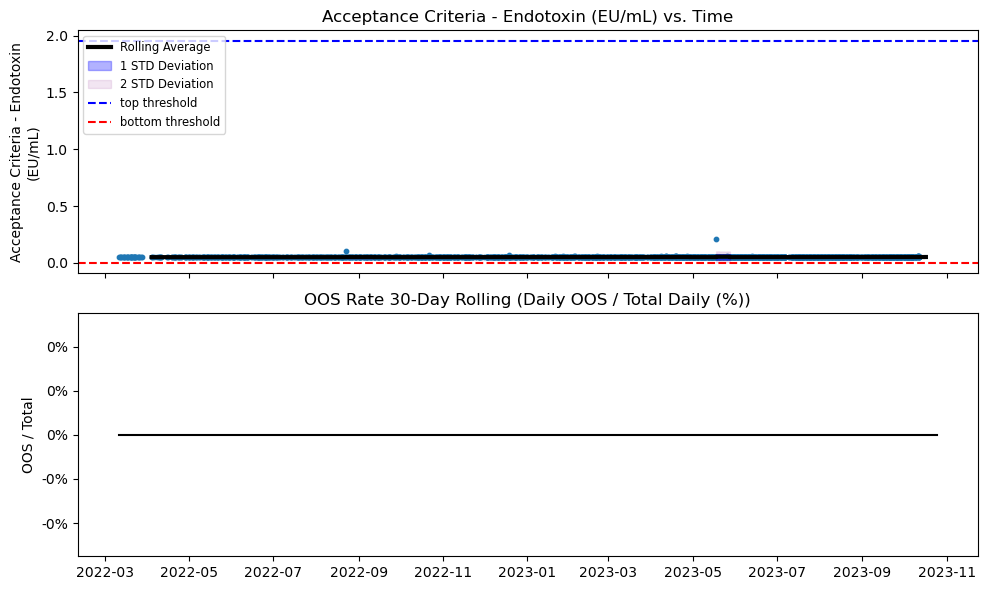

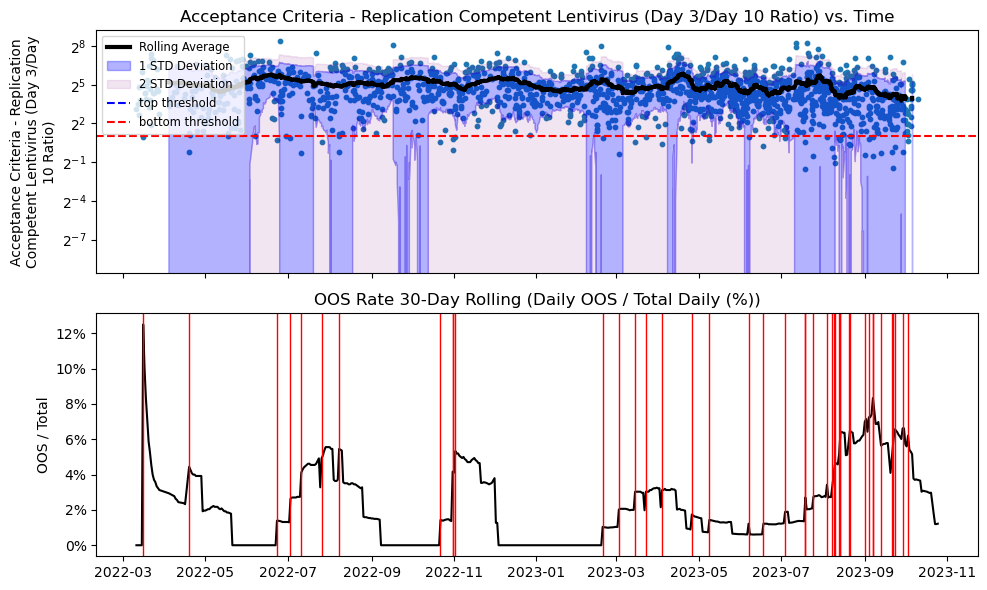

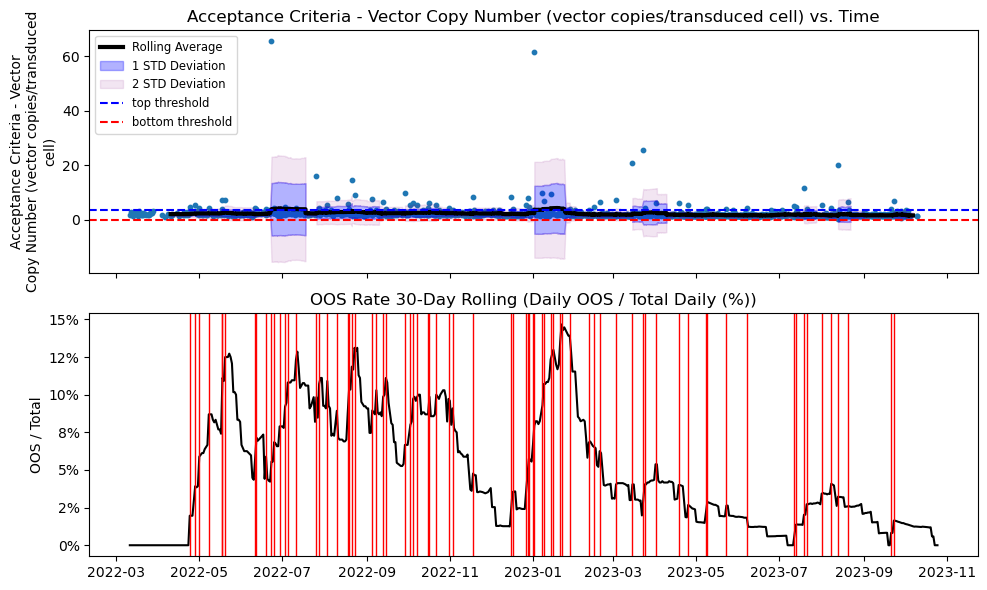

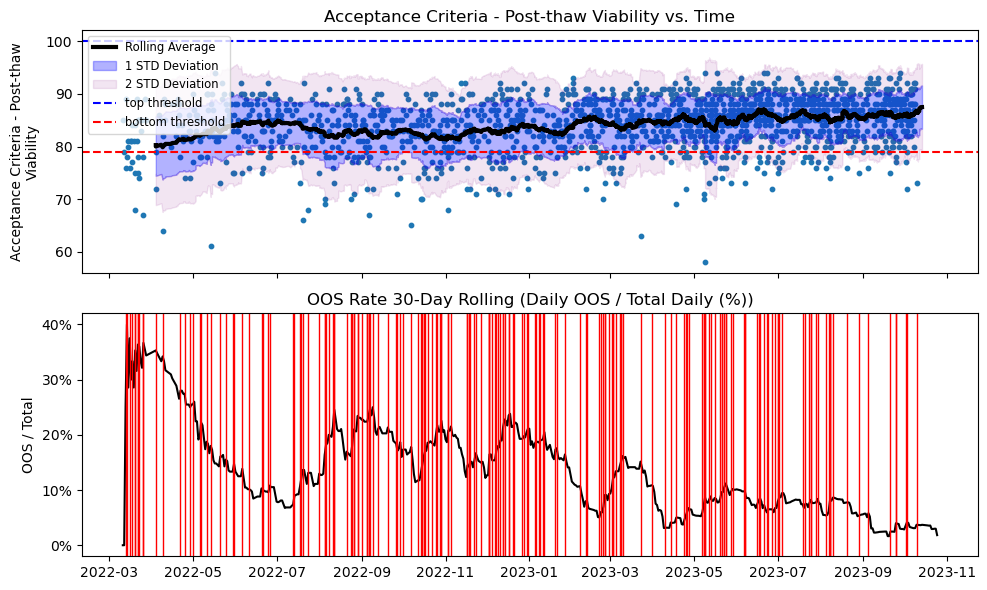

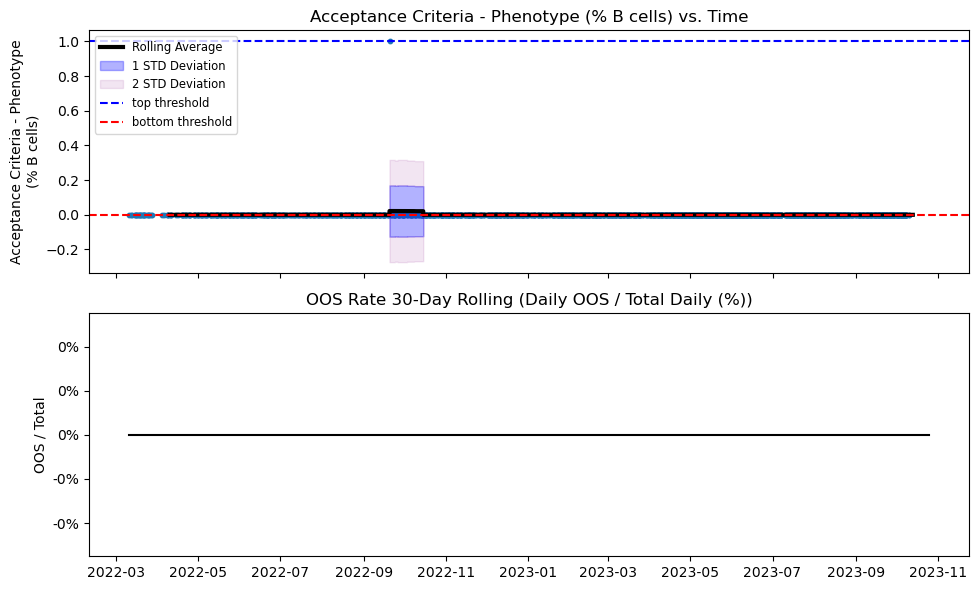

...

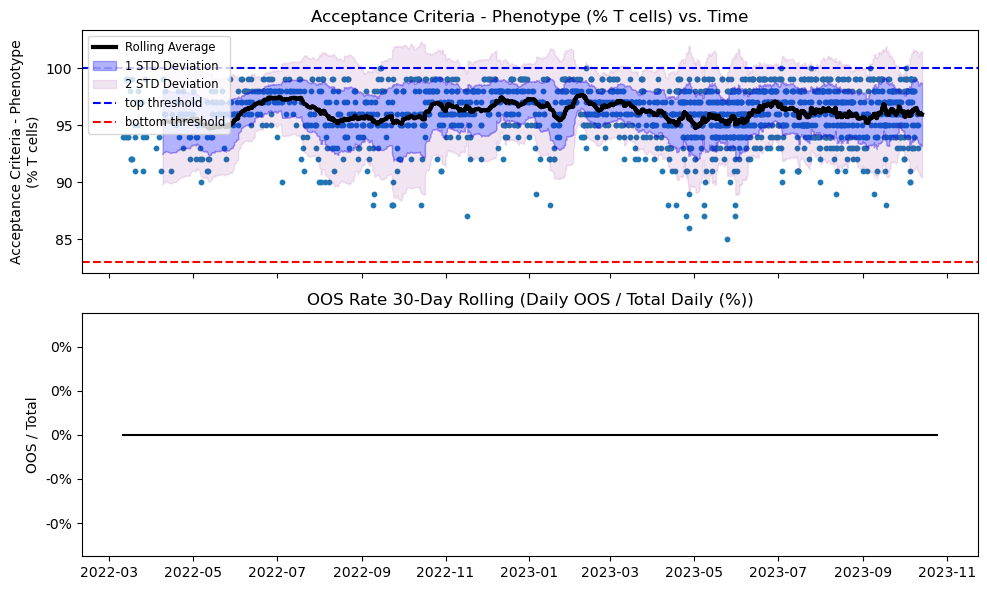

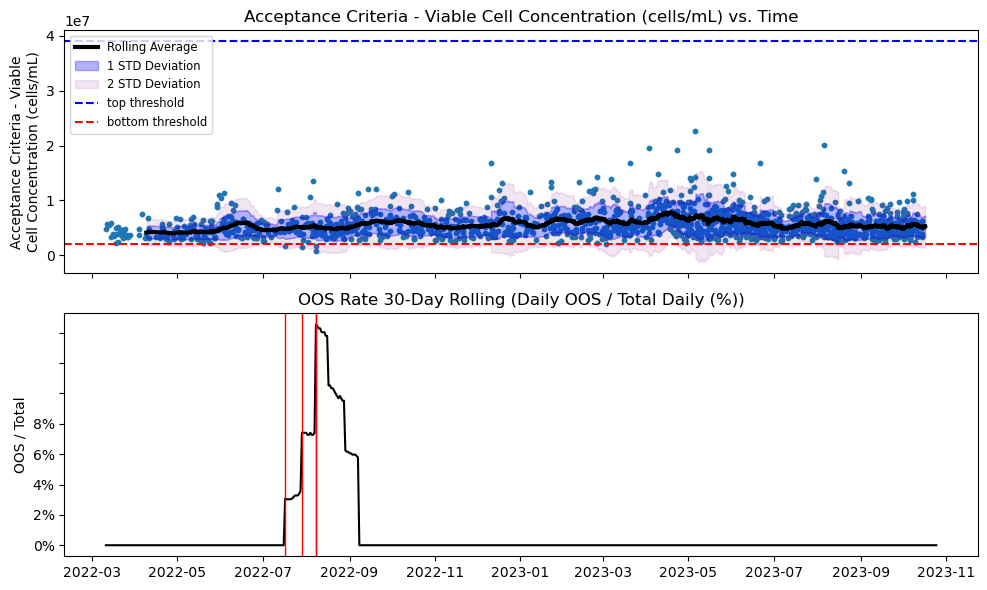

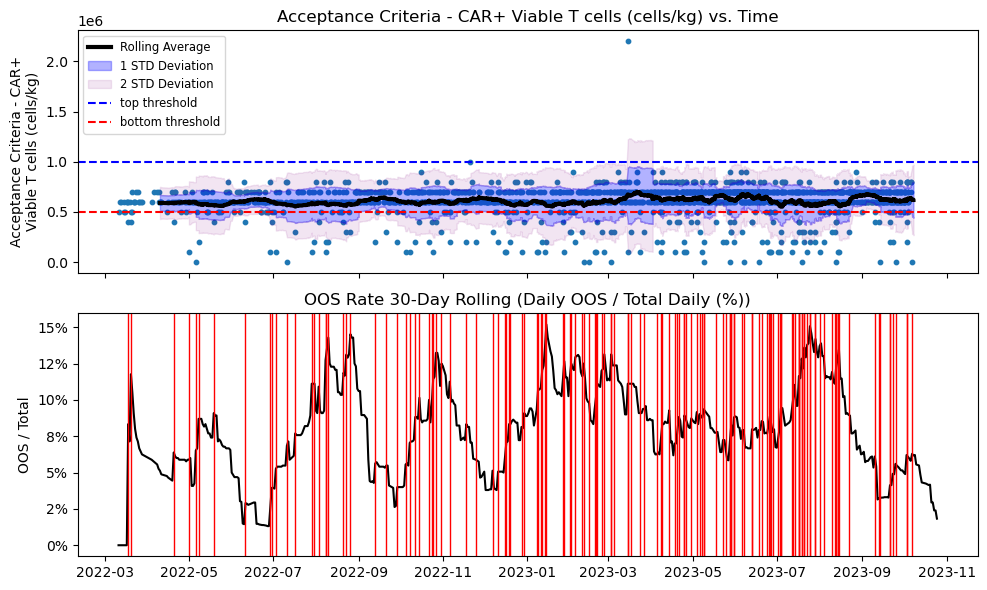

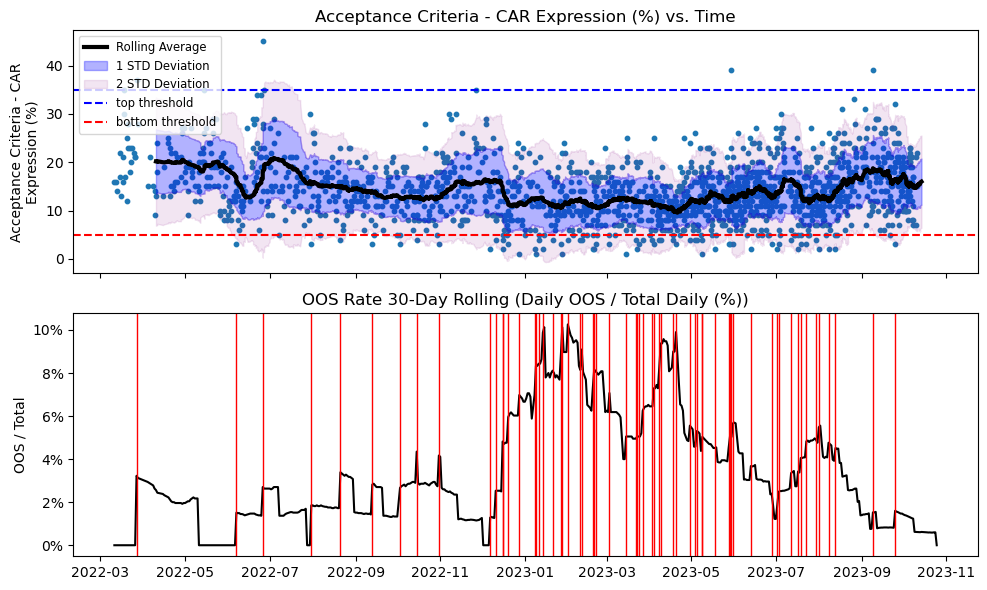

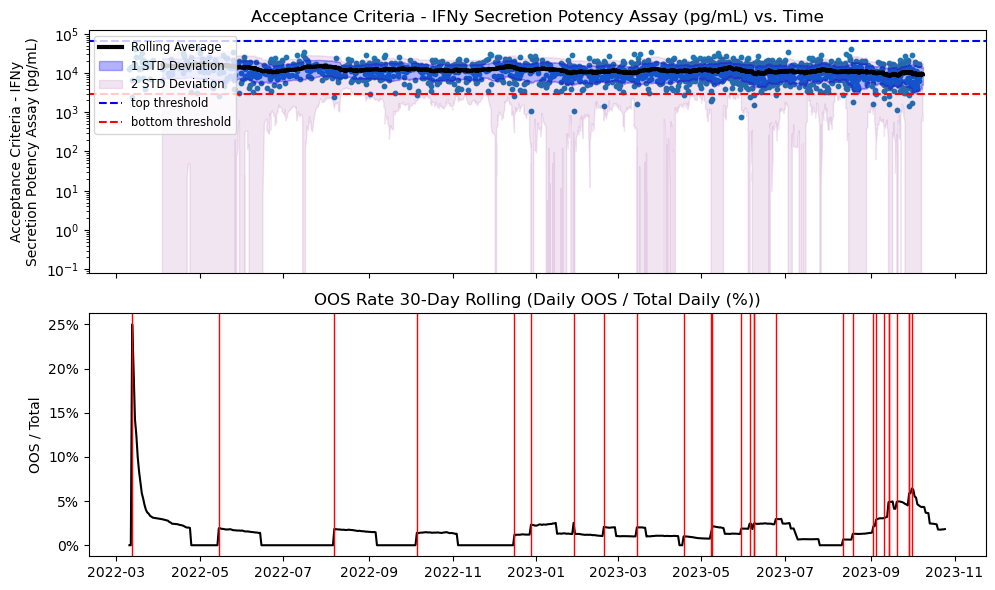

In [24]:
# Create Subdirectory
sub_dir_2 = 'Combined_Trend_OOS_Plots'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))

# Dictionary for statistics
D = {'column': [],
    'num_plotted':[],
     'num_not_shown':[],
     'avg_at_end':[],
     'SD_at_end':[],
     'num_OOS':[],
     'pct_OOS':[]}

win = 30
for i, col in enumerate(cols[1:]):

    fig, axs = plt.subplots(2, 1, figsize=(10, 6), sharex=True)

    # Scatter plot
    axs[0].scatter(df2['Date of Manufacture Start'], df2[col], s=10)

    # Calculate the rolling average with a window size of 50 and min_periods of 30
    df2['Rolling_Avg'] = df2[col].rolling(window=50, min_periods=30).mean()
    df2['Rolling_Std'] = df2[col].rolling(window=50, min_periods=30).std()

    # Plot the rolling average
    axs[0].plot(df2['Date of Manufacture Start'], df2['Rolling_Avg'], color='black', label='Rolling Average', lw=3)

    # Adding the 1SD band
    axs[0].fill_between(df2['Date of Manufacture Start'],
                    df2['Rolling_Avg'] - df2['Rolling_Std'],
                    df2['Rolling_Avg'] + df2['Rolling_Std'],
                    color='blue', alpha=0.3, label='1 STD Deviation')

    # Adding the Upper 2SD band
    axs[0].fill_between(df2['Date of Manufacture Start'],
                    df2['Rolling_Avg'] + df2['Rolling_Std'],
                    df2['Rolling_Avg'] + 2 * df2['Rolling_Std'],
                    color='purple', alpha=0.1, label='2 STD Deviation')

    # Adding the Lower 2SD band
    axs[0].fill_between(df2['Date of Manufacture Start'],
                    df2['Rolling_Avg'] - df2['Rolling_Std'],
                    df2['Rolling_Avg'] - 2 * df2['Rolling_Std'],
                    color='purple', alpha=0.1)  # , label='2 STD Deviation') # None

    # Add threshold lines
    X_floor_under_100kg, X_ceil_under_100kg = spec[col][0], spec[col][3]  # >100kg  X-Thresholds
    axs[0].axhline(y=X_ceil_under_100kg, color='b', linestyle='--', label='top threshold')
    axs[0].axhline(y=X_floor_under_100kg, color='r', linestyle='--', label='bottom threshold')

    # Adding title and labels
    axs[0].set_title(f'{col} vs. Time')
    # Insert /n for axis
    def insert_newlines(label):
        words = label.split()
        grouped_words = [' '.join(words[i:i+4]) for i in range(0, len(words), 4)]
        return '\n'.join(grouped_words)
    #
    axs[0].set_ylabel(insert_newlines(col))
    axs[0].legend(fontsize='small', loc='upper left')

    # Add 'temp' to the second subplot and calculate rolling 5-day OOS average by Manufacture Start Date
    df2['temp'] = np.where((df2[col] < X_floor_under_100kg) | (df2[col] > X_ceil_under_100kg), 1, 0)
    df2b = df2.groupby([df2['Date of Manufacture Start'].dt.date]).sum()
    df2b['Count_per_Date'] = df2.groupby(df2['Date of Manufacture Start'].dt.date).size().values

    # Calculate rolling 5-day sums and counts
    df2b['rolling_OOS_Sum'] = df2b['temp'].rolling(window=win, min_periods=1).sum()
    df2b['rolling_Record_Count'] = df2b['Count_per_Date'].rolling(window=win, min_periods=1).sum()

    # Calculate rolling 5-day OOS percentage
    df2b['rolling_OOS_Percentage'] = (df2b['rolling_OOS_Sum'] / df2b['rolling_Record_Count'] * 100)

    # Plot the rolling OOS percentage by Manufacture Start Date
    axs[1].plot(df2b.index, df2b['rolling_OOS_Percentage'], ls='-', color='black')

    # Find peaks in daily_oos_percentage by comparing adjacent values
    peaks, _ = find_peaks(df2b['rolling_OOS_Percentage'], height=5)

#     # Get the dates and values of the peaks
#     peak_dates = df2b.index[peaks]
#     peak_values = df2b['rolling_OOS_Percentage'].iloc[peaks]

#     # Plot red vertical lines at the peak positions
#     for peak_date, peak_value in zip(peak_dates, peak_values):
#         axs[1].axvline(peak_date, color='red', linestyle='-', linewidth=1)

    OOS_indices = (df2[col] > X_ceil_under_100kg) | (df2[col] < X_floor_under_100kg)

    # Plot red vertical lines for each OOS point in axs[0]
    for oos_index in df2.index[OOS_indices]:
        axs[1].axvline(x=df2['Date of Manufacture Start'].iloc[oos_index], color='red', linestyle='-', linewidth=1)

    # Adding title and labels to the second subplot
    axs[1].set_title(f'OOS Rate {str(win)}-Day Rolling (Daily OOS / Total Daily (%))')
    axs[1].set_ylabel('OOS / Total')

    # Change y-axis tickers to display percentages
    axs[1].set_yticklabels(['{:.0f}%'.format(y) for y in axs[1].get_yticks()])

    # Save Statistics
    D['column'].append(col)
    num_plotted = len(df2[df2[col].notnull()])
    D['num_plotted'].append(num_plotted)
    D['num_not_shown'].append(len(df2[df2[col].isnull()]))

    # Last Mean and STD
    last_mean = df2['Rolling_Avg'].dropna().tail(1).values[0]
    last_sd = df2['Rolling_Std'].dropna().tail(1).values[0]
    D['avg_at_end'].append(last_mean)
    D['SD_at_end'].append(last_sd)

    inspec_criteria = (df2[col]<=X_ceil_under_100kg) & (df2[col]>=X_floor_under_100kg)
    OOS_criteria =    (df2[col]> X_ceil_under_100kg) | (df2[col] <X_floor_under_100kg)
    # X values (that does not include Nan)
    inspec = df2[inspec_criteria][col].values
    OOS = df2[OOS_criteria][col].values
    D['num_OOS'].append(len(OOS))
    D['pct_OOS'].append(len(OOS)/num_plotted*100)

    # Use Log base 2 for these graphs
    if col == 'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)':
        axs[0].set_yscale('log', base=2)
    if col == 'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)':
        axs[0].set_yscale('log', base=10)

    # Combined OOS Plot
    col_replaced = re.sub(r'[\(\)/]', '_', col) # replace characters that interfere with saving file
    fig.savefig(os.path.join(dir_name, sub_dir, sub_dir_2, f'{col_replaced}{i}.png'), dpi=300, bbox_inches='tight')
    fig.tight_layout()
    fig.show()



In [25]:
# Save the CSV of stats to the directory\
time_stats = pd.DataFrame(D)
file_path = os.path.join(dir_name, sub_dir, sub_dir_2, "time_stats.csv")
time_stats.to_csv(file_path)
time_stats

,column,num_plotted,num_not_shown,avg_at_end,SD_at_end,num_OOS,pct_OOS
0,Acceptance Criteria - Endotoxin (EU/mL),1725,175,5.133333e-02,3.457459e-03,0,0.000000
1,Acceptance Criteria - Replication Competent Le...,1631,269,1.574342e+01,2.101704e+01,43,2.636419
2,Acceptance Criteria - Vector Copy Number (vect...,1664,236,1.678667e+00,5.567996e-01,76,4.567308
3,Acceptance Criteria - Post-thaw Viability,1704,196,8.750000e+01,4.116828e+00,196,11.502347
4,Acceptance Criteria - Phenotype (% B cells),1695,205,0.000000e+00,0.000000e+00,0,0.000000
5,Acceptance Criteria - Phenotype (% NK cells),1695,205,6.333333e-01,1.809617e+00,9,0.530973
6,Acceptance Criteria - Phenotype (% T cells),1699,201,9.593333e+01,2.765967e+00,0,0.000000
7,Acceptance Criteria - Viable Cell Concentratio...,1476,424,5.277333e+06,1.910308e+06,4,0.271003
8,Acceptance Criteria - CAR+ Viable T cells (cel...,1656,244,6.200000e+05,1.749877e+05,147,8.876812
9,Acceptance Criteria - CAR Expression (%),1697,203,1.600000e+01,4.763366e+00,64,3.771361


# Stacked Graph of Moving Average (Combined Trend OOS PLOTS)

/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/2211279599.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['Date of Manufacture Start'] = pd.to_datetime(df2['Date of Manufacture Start'])


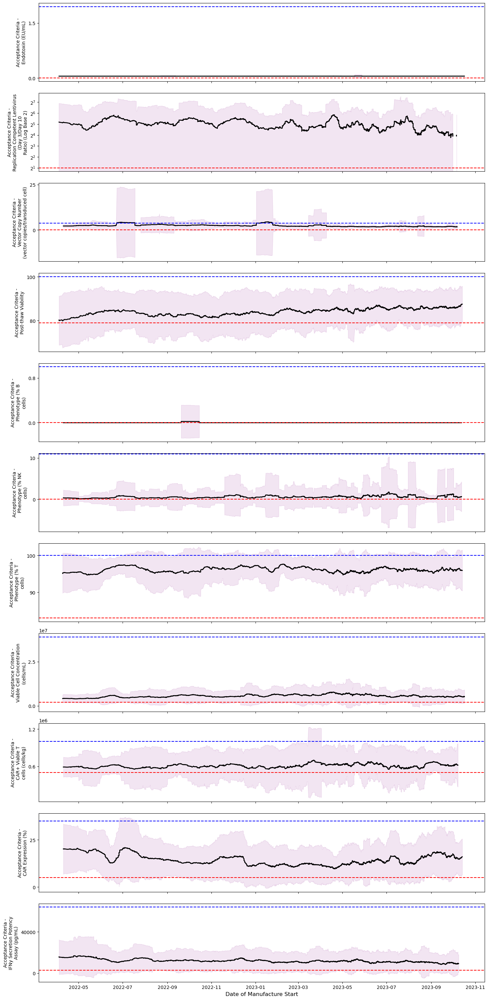

In [26]:
from matplotlib.ticker import MaxNLocator

sub_dir = 'Acceptance_Criteria_Manufacturing_Trends'
sub_dir_2 = 'Combined_Trend_OOS_Plots'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))

# Deal with non Float numbers
cols = ['Date of Manufacture Start',
        'Acceptance Criteria - Endotoxin (EU/mL)',
        'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)',
        'Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)',
        'Acceptance Criteria - Post-thaw Viability',
        'Acceptance Criteria - Phenotype (% B cells)',
        'Acceptance Criteria - Phenotype (% NK cells)',
        'Acceptance Criteria - Phenotype (% T cells)',
        'Acceptance Criteria - Viable Cell Concentration (cells/mL)',
        'Acceptance Criteria - CAR+ Viable T cells (cells/kg)',
        'Acceptance Criteria - CAR Expression (%)',
        'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)']

df2 = df[cols]
df2['Date of Manufacture Start'] = pd.to_datetime(df2['Date of Manufacture Start'])

# Sort the DataFrame by the 'Date' column
df2 = df2.sort_values(by='Date of Manufacture Start', ascending=True)
df2.reset_index(drop=True, inplace=True)

# Create a figure and subplots (axes)
fig, axes = plt.subplots(nrows=len(cols)-1, sharex=True, figsize=(18, 30))

for i, (col, ax) in enumerate(zip(cols[1:], axes)):
  #plt.axis.set_major_formatter(DateFormatter("%m - %Y"))
  #plt.axis.Axis.major_formatter(DateFormatter("%m - %Y"))
  # Calculate the rolling average with a window size of 2
  df2['Rolling_Avg'] = df2[col].rolling(window=50, min_periods=30).mean()
  df2['Rolling_Std'] = df2[col].rolling(window=50, min_periods=30).std()

  # Adding the 2SD band
  ax.fill_between(df2['Date of Manufacture Start'],
                 df2['Rolling_Avg'] + 2*df2['Rolling_Std'],
                 df2['Rolling_Avg'] - 2*df2['Rolling_Std'],
                 color='purple', alpha=0.1, label='2 STD Deviation')

  # Plot the rolling average
  ax.plot(df2['Date of Manufacture Start'], df2['Rolling_Avg'], color='black', label=f'50-day Rolling Average', lw=2)
  # ax.set_ylabel(col)

  # Add threshold lines
  X_floor_under_100kg, X_ceil_under_100kg = spec[col][0], spec[col][3]   # >100kg  X-Thresholds
  ax.axhline(y=X_ceil_under_100kg, color='b', linestyle='--', label= 'top threshold')
  ax.axhline(y=X_floor_under_100kg, color='r', linestyle='--', label='bottom threshold')

  #Change X tickers to Quarter/Year
  #months = mdates.MonthLocator((1,4,7,10))
  #ticks = df2[df2['Date of Manufacture Start'].dt.month%3==1]['Date of Manufacture Start']
  #labels = [f'Q{int(ts.month/3)+1}\n{ts.year}' if ts.month == 1
  #        else f'Q{int(ts.month/3)+1}' for ts in ticks]

  #plt.xticks(ticks, labels=labels)
  #plt.xticks(df2['Date of Manufacture Start'].dt.year, minor=True)

  # Set the y-axis to have a maximum of 2 ticks
  ax.yaxis.set_major_locator(MaxNLocator(nbins=2))

  # Insert /n for axis
  def insert_newlines(label):
      words = label.split()
      grouped_words = [' '.join(words[i:i+3]) for i in range(0, len(words), 3)]
      return '\n'.join(grouped_words)
  col_wrap = insert_newlines(col)

  # 1 legend
  # if i==0:
    # ax.legend(fontsize='medium', loc='upper right')

  # Adding title and labels
  # Use Log base 2 for these graphs
  if col == 'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)':
    ax.set_yscale('log', base=2)
    ax.set_ylabel(f'{col_wrap} (Log Base 2)', fontsize=10)
  else:
    ax.set_ylabel(col_wrap, fontsize=10)

axes[-1].set_xlabel('Date of Manufacture Start', fontsize=12)
plt.tight_layout()

plt.subplots_adjust(left=0.25)
plt.show()
# Save the plot as a .png file within the created directory
file_path = os.path.join(dir_name, sub_dir, sub_dir_2, "Stacked_Line_50D_MA.png")
fig.savefig(file_path)


# Violin Part 1

In [27]:
# # Create sub-directory
# sub_dir = 'violin'
# if not os.path.exists(os.path.join(dir_name, sub_dir)):
#   os.makedirs(os.path.join(dir_name, sub_dir))

# cols =  ['Acceptance Criteria - Endotoxin (EU/mL)',
#         'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)',
#         'Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)',
#         'Acceptance Criteria - Post-thaw Viability',
#         'Acceptance Criteria - Phenotype (% B cells)',
#         'Acceptance Criteria - Phenotype (% NK cells)',
#         'Acceptance Criteria - Phenotype (% T cells)',
#         'Acceptance Criteria - Viable Cell Concentration (cells/mL)',
#         'Acceptance Criteria - CAR+ Viable T cells (cells/kg)',
#         'Acceptance Criteria - CAR Expression (%)',
#         'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)']

# for col in cols:   # ROW INDEXER

#     col_dir = col.split('Acceptance Criteria - ', 1)[1].split('(')[0]
#     # t_stat, p_value, grp_inspec, grp_OOS = None, None, None, None
#     ###### Get upper/lower limit ######
#     floor, ceil = spec[col][0], spec[col][3]   # <100kg  X-Thresholds
#     subset = df[(df[col].notna() & df[col].ne(''))]
#     # Check if thresholds are the same for ><100kg
#     temp_OOS = df[(df[col] < floor) | (df[col] > ceil)]
#     temp_INS = df[(df[col] >= floor) | (df[col] <= ceil)]

#     if len(temp_OOS) > 0:
#         fig, ax = plt.subplots(figsize=(8, 6))

#         vp = ax.violinplot([temp_INS[col],temp_OOS[col]], showmeans=False, showmedians=True, showextrema=True)

#         # Set facecolor and edgecolor to black
#         for partname in ('cbars', 'cmaxes', 'cmins', 'cmedians'):
#             vp[partname].set_edgecolor('black')


#         ax.scatter([1] * len(temp_INS), temp_INS[col], color='blue', label='In Spec', alpha = 0.5)
#         ax.scatter([2] * len(temp_OOS), temp_OOS[col], color='#ff5050', label='Out of Spec', alpha = 0.5)

#         ax.set_xticks([1, 2])
#         ax.set_xticklabels(['In Spec', 'Out of Spec'])
#         ax.set_title(col_dir)
#         ax.legend(loc='upper right')
#         ax.set_ylabel(col)
#         _, p_value = ttest_ind(temp_OOS[col], temp_INS[col])
#         text_box = f'p-value: {p_value:.4f}'
#         ax.text(1.5, max(max(temp_OOS[col]), max(temp_INS[col])), text_box, ha='center')

#         plt.show()

#         fig.savefig(os.path.join(dir_name, f'{col_dir} In-Spec OOS Violin.png'), dpi=300, bbox_inches='tight')
#     else:
#         fig, ax = plt.subplots(figsize=(8, 6))
#         vp = ax.violinplot([temp_INS[col]], showmeans=False, showmedians=True, showextrema=True)

#         for partname in ('cbars', 'cmaxes', 'cmins', 'cmedians'):
#             vp[partname].set_edgecolor('black')

#         ax.scatter([1] * len(temp_INS), temp_INS[col], color='blue', label='In Spec', alpha = 0.5)

#         ax.set_xticks([1])  # Only one tick position
#         ax.set_xticklabels(['In Spec'])  # Label for the single tick
#         ax.set_ylabel(col)
#         ax.set_title(f'{col_dir} (Only In Spec)')
#         ax.legend(loc='upper right')

#         plt.show()
#         fig.savefig(os.path.join(dir_name, sub_dir, f'{col_dir} In-Spec OOS Violin.png'), dpi=300, bbox_inches='tight')


# Violin Part 2 (Not sure Which subdirectory to place in)
- Check "col_dir" to ensure splitting is correct

In [28]:
# Create sub-directory
sub_dir = 'Process_Mapping_of_Acceptance_Criteria_Correlations'
sub_dir_2 = 'Violin'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))

/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/1394687525.py:39: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  _, p_value = stats.ttest_ind(tempOOS_exclude_outliers[column], temp_INS[column])
/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/1394687525.py:51: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(4, 4))


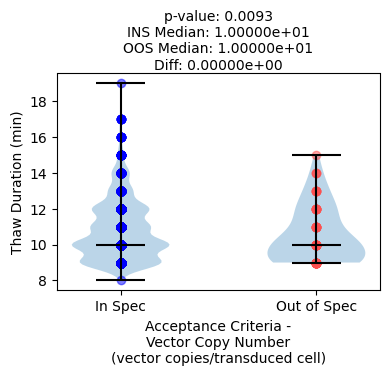

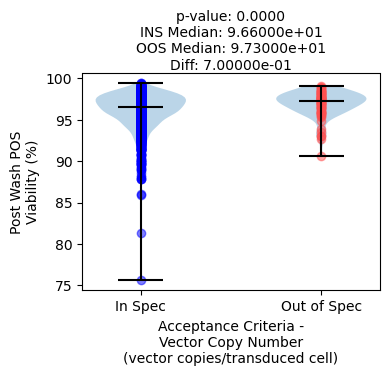

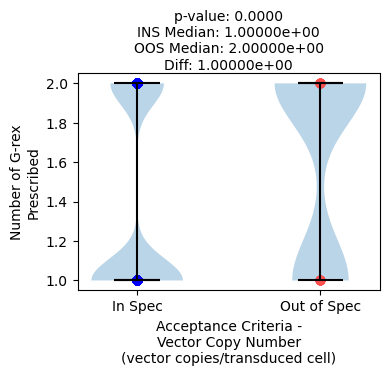

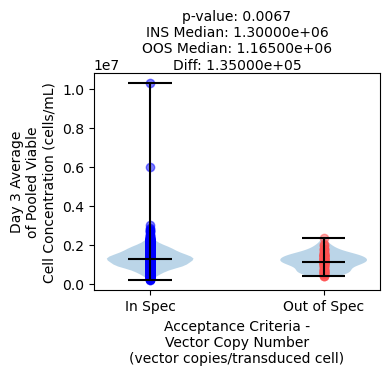

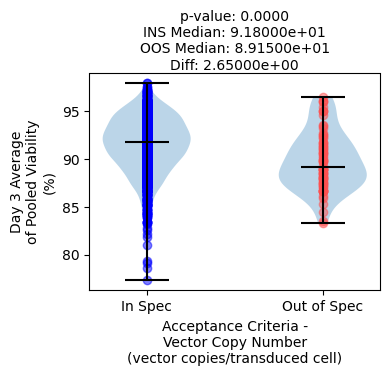

...

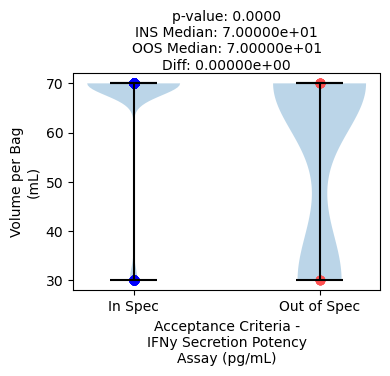

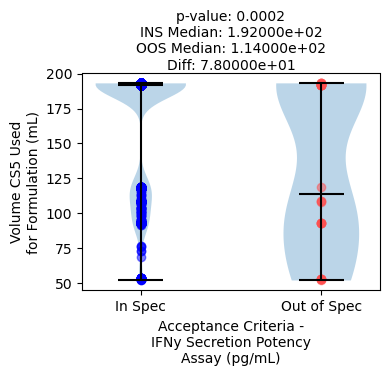

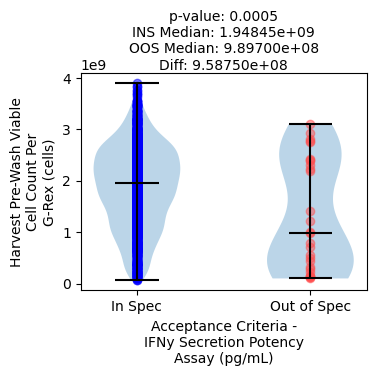

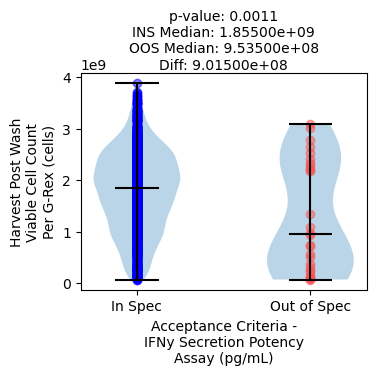

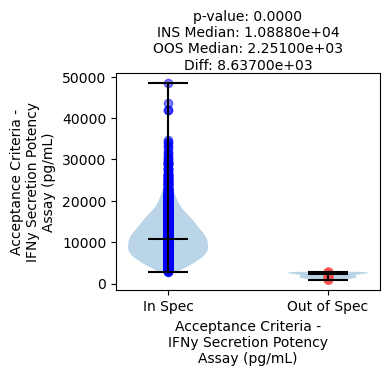

In [29]:
cols =  ['Acceptance Criteria - Appearance of Color',
         'Acceptance Criteria - Appearance of Primary Container',
         'Acceptance Criteria - Rapid Sterility',
         'Acceptance Criteria - Mycoplasma',
         'Acceptance Criteria - CAR Identity',
         'Acceptance Criteria - Endotoxin (EU/mL)',
         'Acceptance Criteria - Replication Competent Lentivirus (Day 3/Day 10 Ratio)',
         'Acceptance Criteria - Vector Copy Number (vector copies/transduced cell)',
         'Acceptance Criteria - Post-thaw Viability',
         'Acceptance Criteria - Phenotype (% B cells)',
         'Acceptance Criteria - Phenotype (% NK cells)',
         'Acceptance Criteria - Phenotype (% T cells)',
         'Acceptance Criteria - Viable Cell Concentration (cells/mL)',
         'Acceptance Criteria - CAR+ Viable T cells (cells/kg)',
         'Acceptance Criteria - CAR Expression (%)',
         'Acceptance Criteria - IFNy Secretion Potency Assay (pg/mL)']

# Batches to Look at
batches = ['23COM114', '23COM115', '23COM116', '23COM117']

for i, col in enumerate(cols):
    col_dir = col.split('Acceptance Criteria - ', 1)[1].split('(')[0]

    floor, ceil = spec[col][0], spec[col][3]
    subset = df[(df[col].notna() & df[col] != '')]

    if floor == 0 and ceil == 3:  # Adjust the condition based on your actual data
        temp_OOS = subset[subset[col] == floor]
        temp_INS = subset[subset[col] == ceil]
    else:
        temp_OOS = subset[(subset[col] < floor) | (subset[col] > ceil)]
        temp_INS = subset[(subset[col] >= floor) & (subset[col] <= ceil)]

    numeric_columns = df.select_dtypes(include=['int64', 'float64'])
    subplot_columns = []

    for j, column in enumerate(numeric_columns.columns):
        tempOOS_exclude_outliers = temp_OOS[np.abs(stats.zscore(temp_OOS[column])) < 2]
        _, p_value = stats.ttest_ind(tempOOS_exclude_outliers[column], temp_INS[column])

        if p_value < 0.01:
    #         subplot_columns.append({
    #             'column_name': column,
    #             'p_value': p_value
    #         })
            sub_dir_3 = f'{col_dir} In-Spec OOS Violin'
            if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2, sub_dir_3)):
              os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2, sub_dir_3))
            column_name = column.split('(')[0].split('/')[0]

            fig, ax = plt.subplots(figsize=(4, 4))

            vp = ax.violinplot([temp_INS[column], temp_OOS[column]],
                               showmeans=False, showmedians=True, showextrema=True)
            # Set facecolor and edgecolor to black
            for partname in ('cbars', 'cmaxes', 'cmins', 'cmedians'):
                vp[partname].set_edgecolor('black')

            ax.scatter([1] * len(temp_INS), temp_INS[column], color='blue', label='In Spec', alpha=0.5)
            ax.scatter([2] * len(temp_OOS), temp_OOS[column], color='#ff5050', label='Out of Spec', alpha=0.5)

            ax.set_xticks([1, 2])
            ax.set_xticklabels(['In Spec', 'Out of Spec'])
            ax.set_ylabel(insert_newlines(column))
            ax.set_xlabel(insert_newlines(col))

            INS_median = temp_INS[column].median()
            OOS_median = temp_OOS[column].median()
            median_diff = abs(INS_median - OOS_median)
            text_box = f'p-value: {p_value:.4f}\nINS Median: {INS_median:.5e}\nOOS Median: {OOS_median:.5e}\nDiff: {median_diff:.5e}'
            text_box_x = 0.5  # Centered horizontally
            text_box_y = 1.15  # Positive value to move it above the plot
            ax.text(text_box_x, text_box_y, text_box, ha='center', va='center', transform=ax.transAxes)

             #for batch in batches:
             #    plt.scatter(df[df['Patient Lot/Batch #'] == batch]['Patient Lot/Batch #'], df[df['Patient Lot/Batch #'] == batch][column], label=f"Batch {batch} - {column}")

             #ax.set_xlabel("Batch ID")
            plt.tight_layout()
            fig.savefig(os.path.join(dir_name, sub_dir, sub_dir_2, sub_dir_3, f'{column_name}{j} In-Spec OOS Violin.png'), dpi=300, bbox_inches='tight')



## STACKED BAR Time Plot of Pass/Fail Qualitative Fields Binned by Month

/var/folders/mq/2fkcsmgn0_x809fdbcqpjj2w0000gn/T/ipykernel_4820/637155791.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3['Date of Manufacture Start'] = pd.to_datetime(df3['Date of Manufacture Start'])


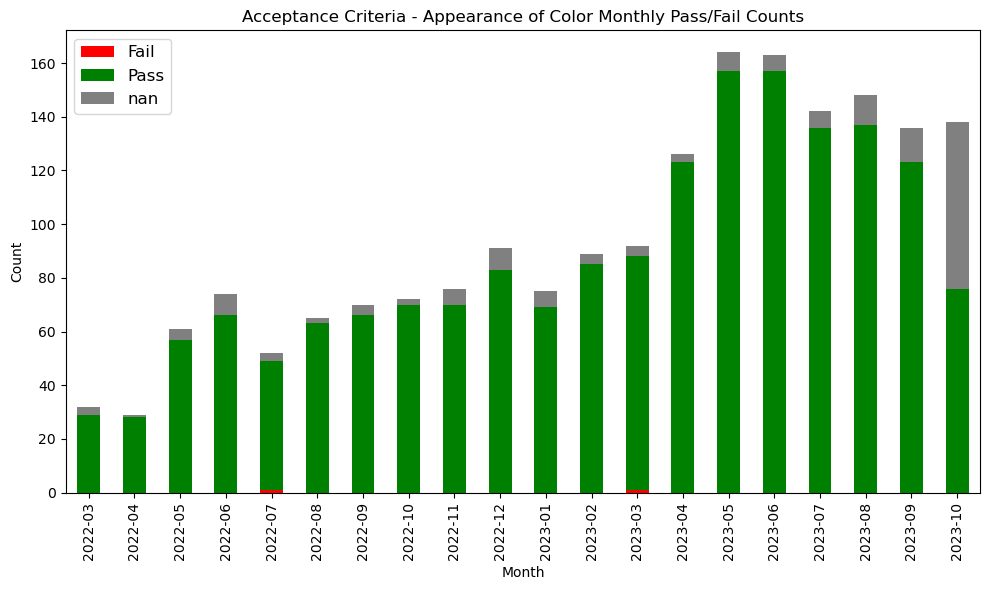

<Figure size 640x480 with 0 Axes>

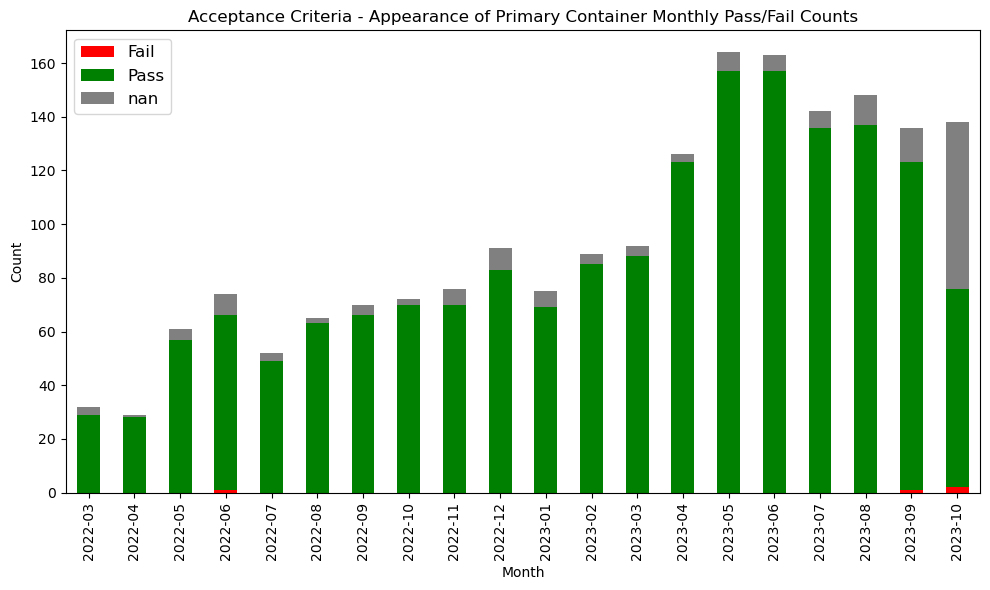

<Figure size 640x480 with 0 Axes>

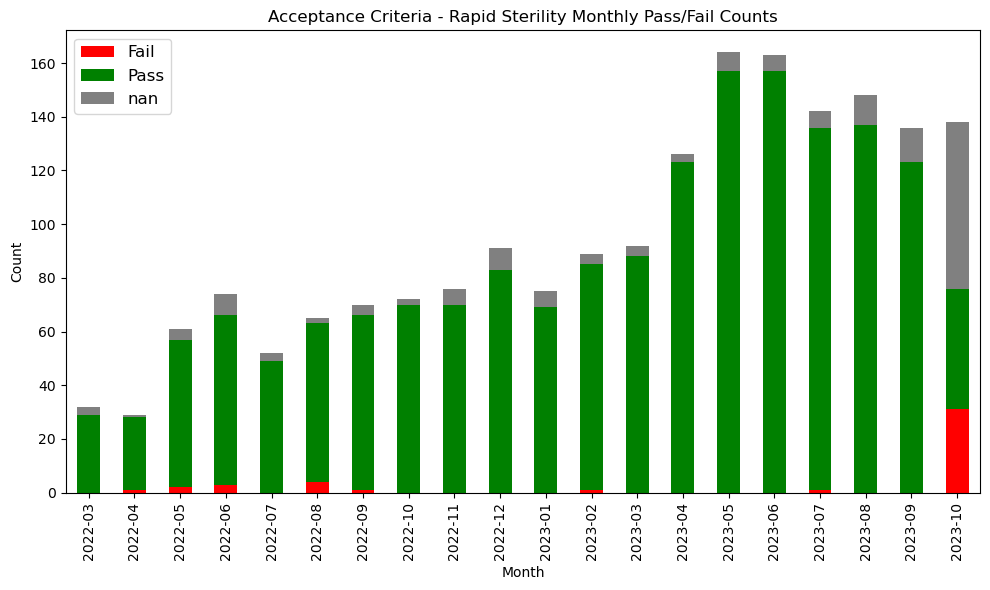

<Figure size 640x480 with 0 Axes>

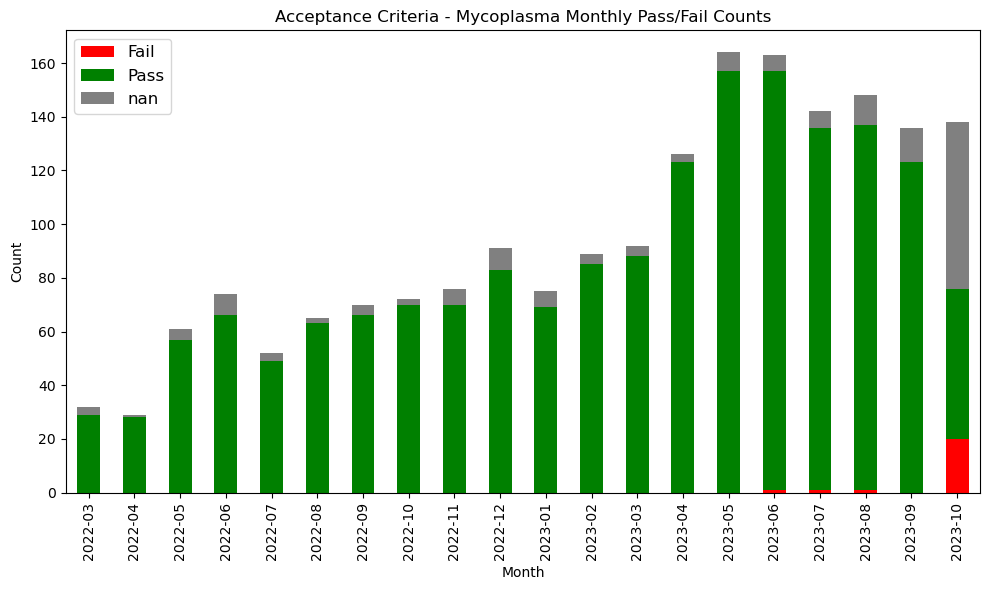

<Figure size 640x480 with 0 Axes>

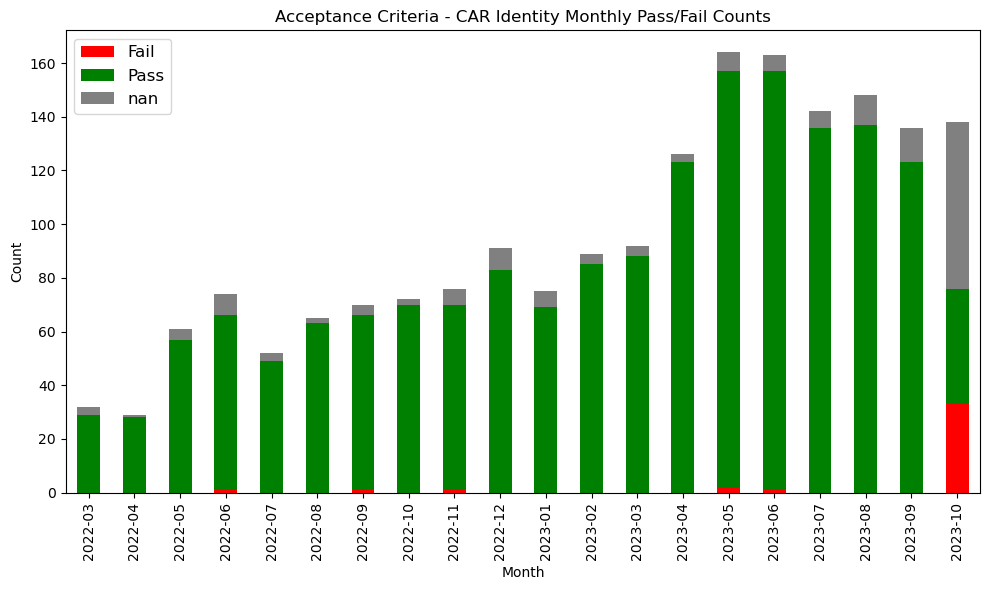

<Figure size 640x480 with 0 Axes>

In [30]:
# Create sub-directory
sub_dir = 'Acceptance_Criteria_Manufacturing_Trends'
sub_dir_2 = 'Monthly_Pass_Fail_Bar'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))

# Get Qualitative Columns and Date of Manufacture Start
cols = ['Date of Manufacture Start',
        'Acceptance Criteria - Appearance of Color',
        'Acceptance Criteria - Appearance of Primary Container',
        'Acceptance Criteria - Rapid Sterility',
        'Acceptance Criteria - Mycoplasma',
        'Acceptance Criteria - CAR Identity']

df3 = df[cols]
df3['Date of Manufacture Start'] = pd.to_datetime(df3['Date of Manufacture Start'])
# df3['Date of Manufacture Start (Monthly)'] = df2['Date of Manufacture Start'].dt.to_period('M')

for i, col in enumerate(cols[1:]):   # Excluding Date of Manufacture
  # Group by month and criteria and unstack
  monthly_counts = df3.groupby([df3['Date of Manufacture Start'].dt.to_period("M"), col]).size().unstack(fill_value=0)

  # Plotting
  fig, ax = plt.subplots(figsize=(10, 6))
  monthly_counts.plot(kind='bar', stacked=True, color =['red', 'green','gray'],label = ['Fail','Pass', 'nan'], ax=ax)


  # Setting labels and title
  ax.set_ylabel('Count')
  ax.set_xlabel('Month')
  ax.set_title(f'{col} Monthly Pass/Fail Counts')
  ax.legend(loc='upper left', fontsize='large')

  # Save to Directory
  plt.tight_layout()
  plt.show()
  file_path = os.path.join(dir_name, sub_dir, sub_dir_2, f'Qualitative_{col}_Monthly_Pass_Fail Counts.png')
  plt.savefig(file_path, dpi=300, bbox_inches='tight')
  fig.savefig(os.path.join(dir_name, sub_dir, f'{col} Monthly Pass_Fail Counts.png'), dpi=300, bbox_inches='tight')


# LINE Time Plot of Pass/Fail Qualitative Fields Binned by Month

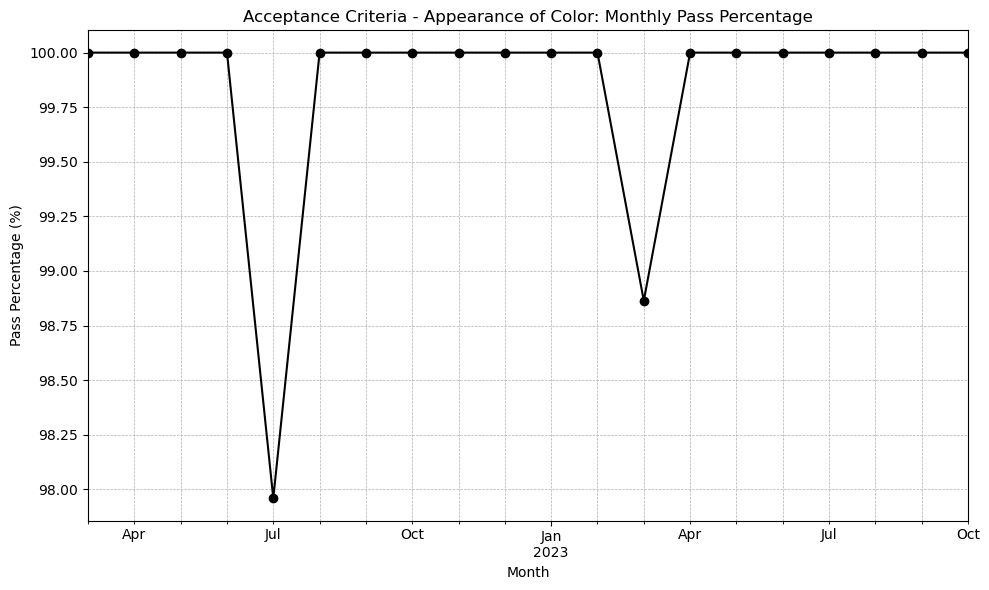

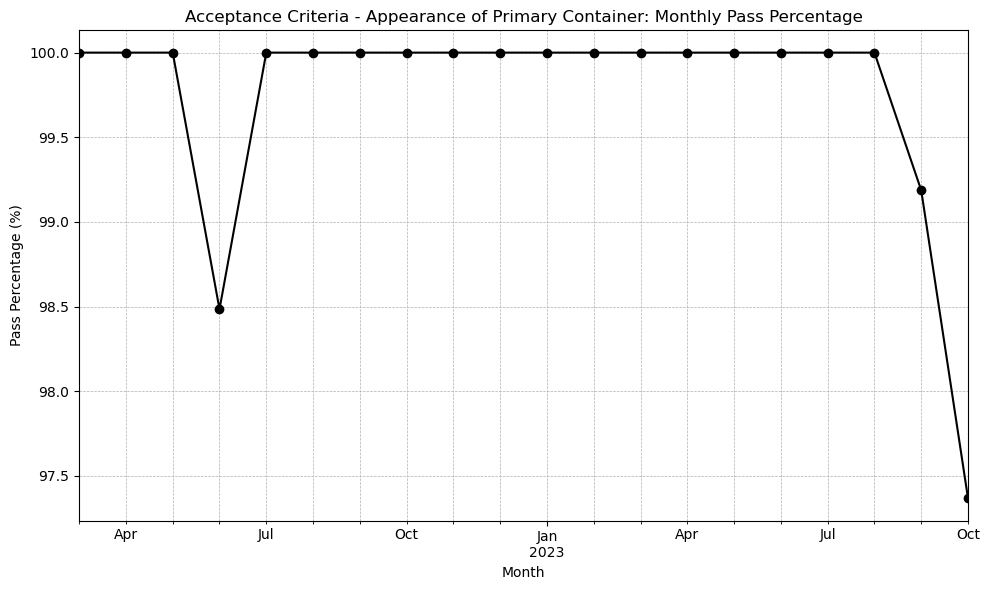

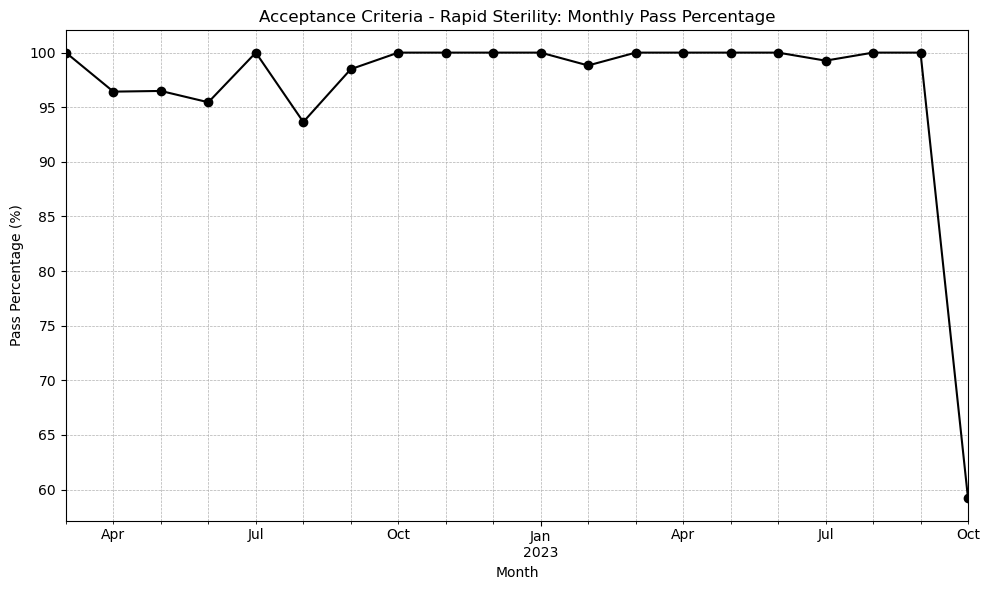

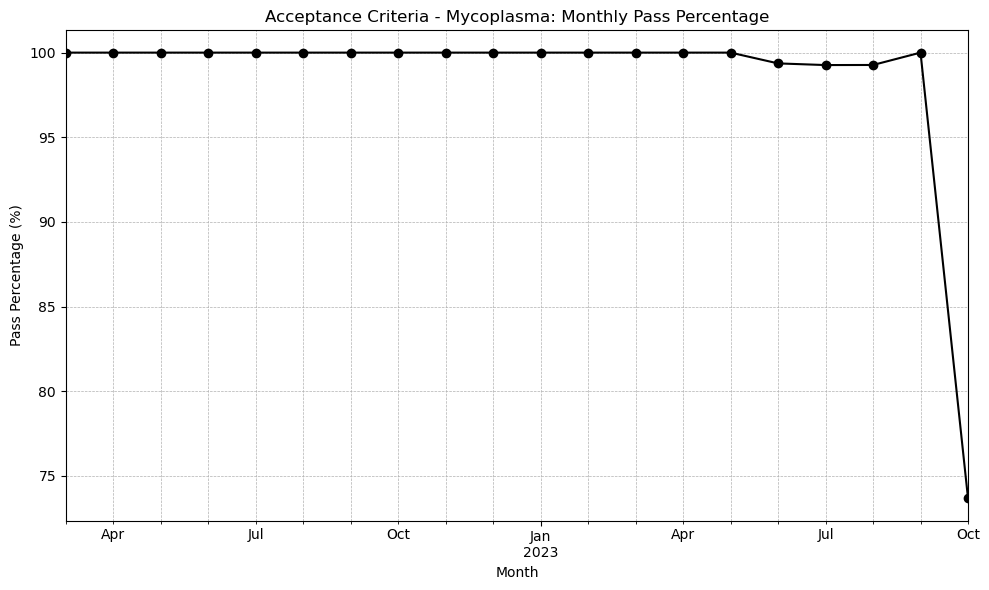

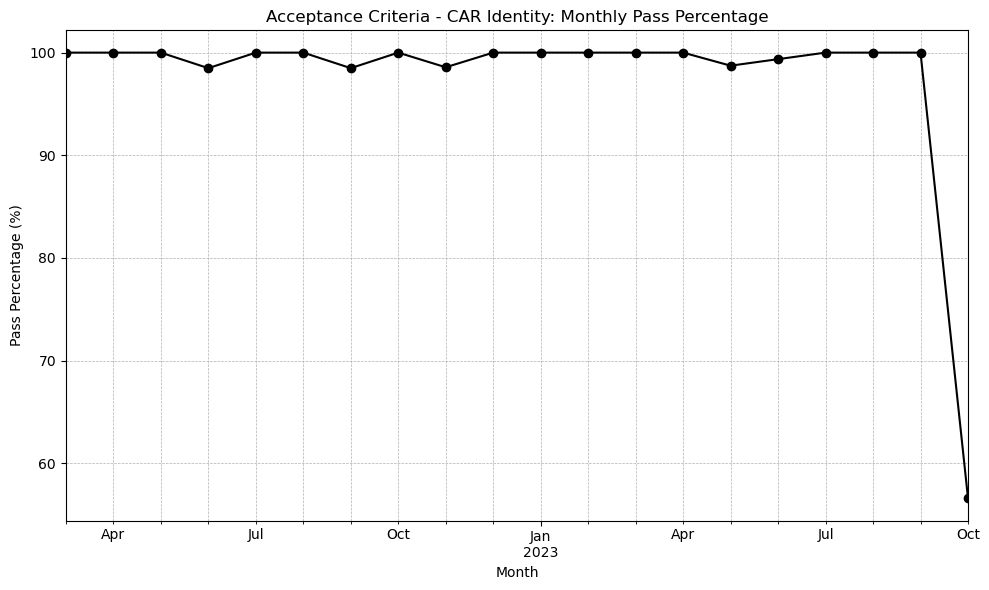

In [31]:
# Create sub-directory
sub_dir = 'Acceptance_Criteria_Manufacturing_Trends'
sub_dir_2 = 'Monthly_Pass_Pct'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))


# Get Qualitative Columns and Date of Manufacture Start
cols = ['Date of Manufacture Start',
        'Acceptance Criteria - Appearance of Color',
        'Acceptance Criteria - Appearance of Primary Container',
        'Acceptance Criteria - Rapid Sterility',
        'Acceptance Criteria - Mycoplasma',
        'Acceptance Criteria - CAR Identity']

for col in cols[1:]:   # Excluding Date of Manufacture

  monthly_counts = df3.groupby([df3['Date of Manufacture Start'].dt.to_period("M"), col]).size().unstack(fill_value=0)

  # Calculate Pass percentage
  monthly_counts['Pass Percentage'] = (monthly_counts['Pass'] / (monthly_counts['Pass'] + monthly_counts['Fail'])) * 100

  # Plotting
  fig, ax = plt.subplots(figsize=(10, 6))
  monthly_counts['Pass Percentage'].plot(kind='line', ax=ax, color='black', marker='o')

  # Setting labels, title, and grid
  ax.set_ylabel('Pass Percentage (%)')
  ax.set_xlabel('Month')
  ax.set_title(f'{col}: Monthly Pass Percentage')
  ax.grid(True, which='both', linestyle='--', linewidth=0.5)

  # Save to Directory
  file_path = os.path.join(dir_name, sub_dir, sub_dir_2, f'Qualitative_{col}_Monthly_Pass_Pct.png')
  plt.savefig(file_path, dpi=300, bbox_inches='tight')
  plt.tight_layout()
  plt.show()

# Monthly FAIL Pct

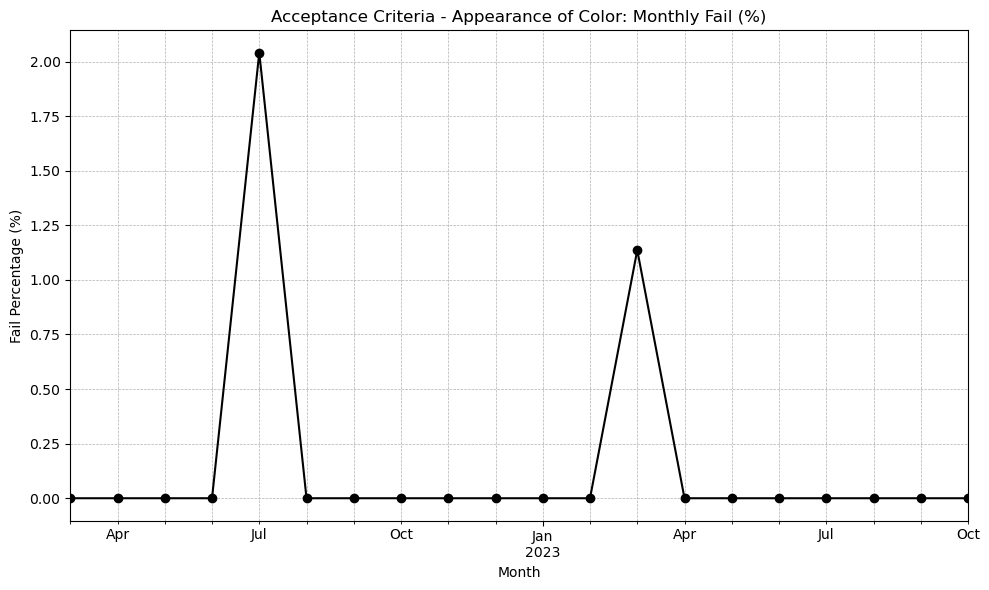

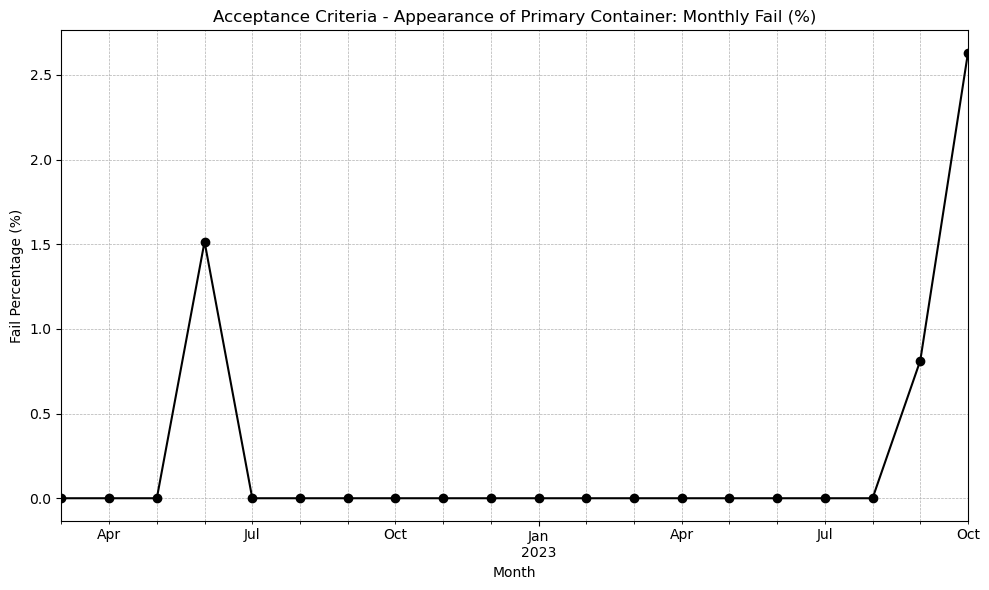

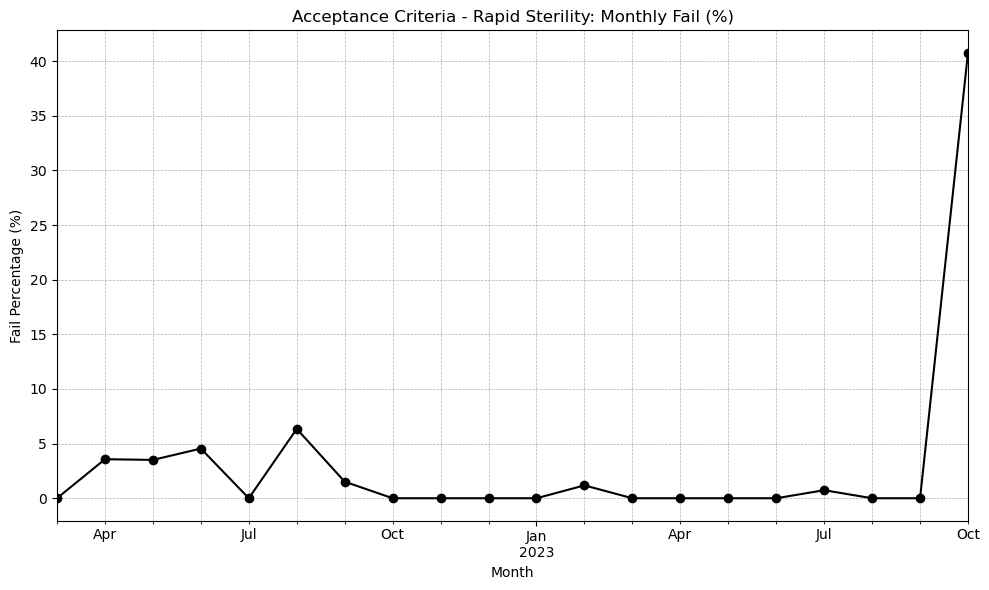

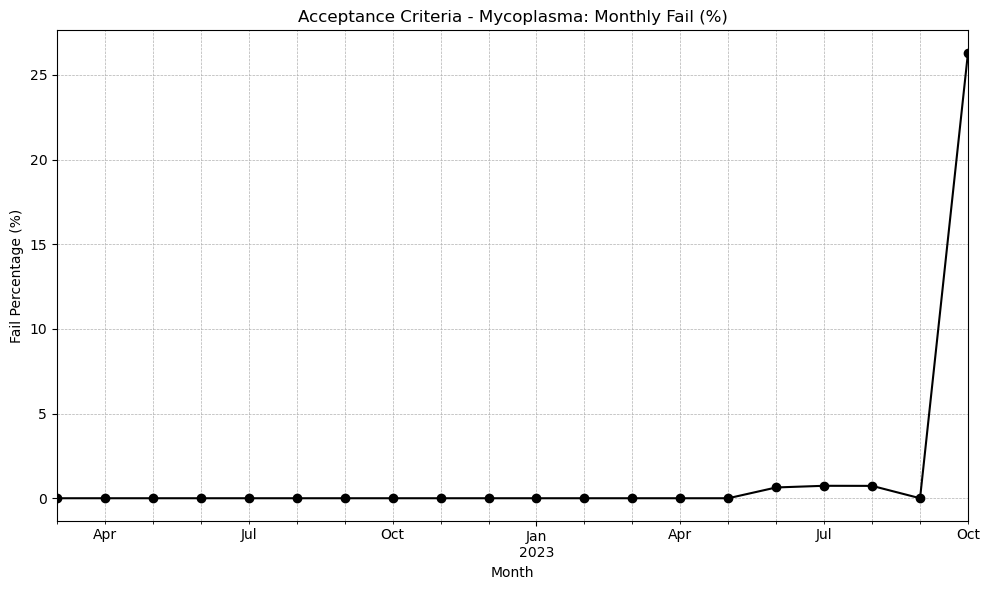

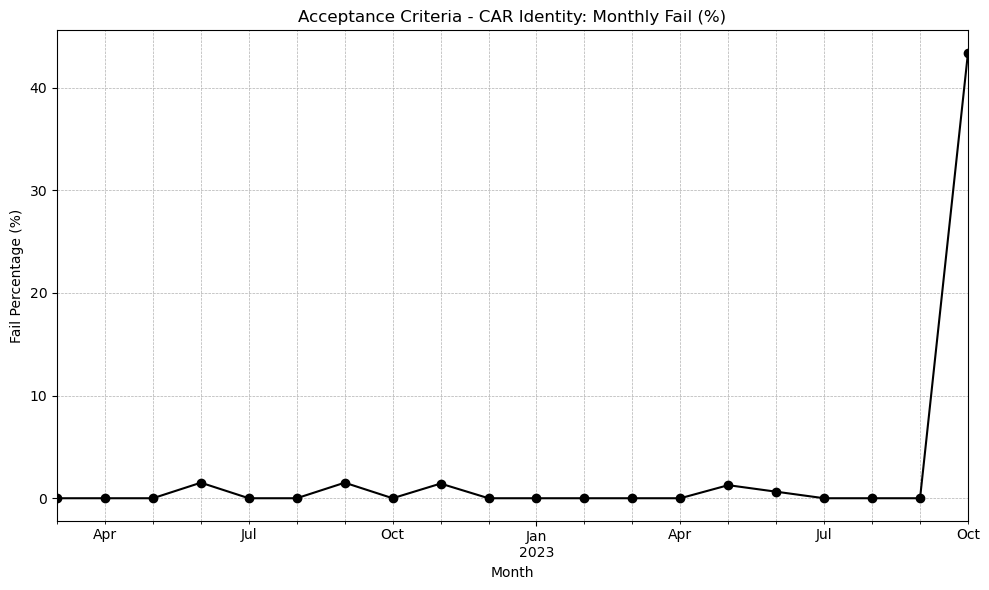

In [32]:
# Create sub-directory
sub_dir = 'Acceptance_Criteria_Manufacturing_Trends'
sub_dir_2 = 'Monthly_Fail_Pct'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))


# Get Qualitative Columns and Date of Manufacture Start
cols = ['Date of Manufacture Start',
        'Acceptance Criteria - Appearance of Color',
        'Acceptance Criteria - Appearance of Primary Container',
        'Acceptance Criteria - Rapid Sterility',
        'Acceptance Criteria - Mycoplasma',
        'Acceptance Criteria - CAR Identity']

for col in cols[1:]:   # Excluding Date of Manufacture

  monthly_counts = df3.groupby([df3['Date of Manufacture Start'].dt.to_period("M"), col]).size().unstack(fill_value=0)

  # Calculate Pass percentage
  monthly_counts['Fail Percentage'] = (monthly_counts['Fail'] / (monthly_counts['Pass'] + monthly_counts['Fail'])) * 100

  # Plotting
  fig, ax = plt.subplots(figsize=(10, 6))
  monthly_counts['Fail Percentage'].plot(kind='line', ax=ax, color='black', marker='o')

  # Setting labels, title, and grid
  ax.set_ylabel('Fail Percentage (%)')
  ax.set_xlabel('Month')
  ax.set_title(f'{col}: Monthly Fail (%)')
  ax.grid(True, which='both', linestyle='--', linewidth=0.5)

  # Save to Directory
  file_path = os.path.join(dir_name, sub_dir, sub_dir_2, f'Qualitative_{col}_Monthly_Fail_Pct.png')
  plt.savefig(file_path, dpi=300, bbox_inches='tight')
  plt.tight_layout()
  plt.show()

In [ ]:
# Create sub-directory
sub_dir = 'Acceptance_Criteria_Manufacturing_Trends'
sub_dir_2 = 'Monthly_Fail_Pct'
if not os.path.exists(os.path.join(dir_name, sub_dir, sub_dir_2)):
  os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2))

cols = ['Date of Manufacture Start',
        'Acceptance Criteria - Appearance of Color',
        'Acceptance Criteria - Appearance of Primary Container',
        'Acceptance Criteria - Rapid Sterility',
        'Acceptance Criteria - Mycoplasma',
        'Acceptance Criteria - CAR Identity']

for col in cols[1:]:  # Excluding 'Date of Manufacture Start'
    subset = df3[df3[col].isin(['Pass', 'Fail'])]

    plt.figure(figsize=(10, 6))
    counts = subset.groupby(['Date of Manufacture Start', col]).size().unstack(fill_value=0)
    combined_data = pd.concat([counts['Pass'], counts['Fail']], axis=1)
    combined_data.columns = ['INS', 'OOS']

    # Create a horizontal jitter plot for 'INS' and 'OOS'
    sns.stripplot(x=combined_data.index, y=combined_data['INS'], color='green', jitter=True, orient='h', label='INS')
    sns.stripplot(x=combined_data.index, y=combined_data['OOS'], color='red', jitter=True, orient='h', label='OOS')

    # Set y-axis tick positions
    plt.yticks(combined_data.index, combined_data.index)

    # Customize the y-axis labels
    plt.gca().set_yticklabels(['INS', 'OOS'])

    # Set labels and title
    plt.xlabel('Date of Manufacture Start')
    plt.ylabel(col)
    plt.title(f'{col}: Monthly Fail')
    
    # Ensure the directories exist
    os.makedirs(os.path.join(dir_name, sub_dir, sub_dir_2), exist_ok=True)
    
    file_path = os.path.join(dir_name, sub_dir, sub_dir_2, f'Qualitative_{col}_Monthly.png')
    plt.savefig(file_path, dpi=300, bbox_inches='tight')
    
    plt.tight_layout()
    plt.show()


# Save and Download Zip Files

In [ ]:
from google.colab import files

# CANNOT Download folder so need to zip
!zip -r Raritan_2023-10-31.zip Raritan_2023-10-31

files.download("Raritan_2023-10-31.zip")